In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)

from datetime import date
import hisepy
import numpy as np
import os
import pandas as pd
import re
import scanpy as sc

## Helper functions

In [2]:
def cache_uuid_path(uuid):
    cache_path = '/home/jupyter/cache/{u}'.format(u = uuid)
    if not os.path.isdir(cache_path):
        hise_res = hisepy.reader.cache_files([uuid])
    filename = os.listdir(cache_path)[0]
    cache_file = '{p}/{f}'.format(p = cache_path, f = filename)
    return cache_file

In [3]:
def read_csv_uuid(uuid):
    cache_file = cache_uuid_path(uuid)
    res = pd.read_csv(cache_file)
    return res

In [4]:
def read_parquet_uuid(uuid):
    cache_file = cache_uuid_path(uuid)
    res = pd.read_parquet(cache_file)
    return res

In [5]:
def read_adata_uuid(uuid):
    cache_file = cache_uuid_path(uuid)
    res = sc.read_h5ad(cache_file)
    return res

In [6]:
def backed_adata_uuid(uuid):
    cache_file = cache_uuid_path(uuid)
    res = sc.read_h5ad(cache_file, backed = 'r')
    return res

In [7]:
def rm_cache_uuid(uuid):
    cache_path = '/home/jupyter/cache/{u}'.format(u = uuid)
    rm_call = 'rm -r {d}'.format(d = cache_path)
    os.system(rm_call)

In [8]:
def format_cell_type(cell_type):
    cell_type = re.sub('\\+', 'pos', cell_type)
    cell_type = re.sub('-', 'neg', cell_type)
    cell_type = re.sub(' ', '_', cell_type)
    return cell_type

In [9]:
def filename_cell_type(filename):
    cell_type = re.sub('.+L3_','',filename)
    cell_type = re.sub('_2024.+','',cell_type)
    cell_type = re.sub('_', ' ', cell_type)
    cell_type = re.sub('pos','+', cell_type)
    cell_type = re.sub('neg','-', cell_type)
    return cell_type

In [10]:
def add_labels(adata, labels):
    obs = adata.obs
    obs = obs.reset_index(drop = True)
    obs = obs.merge(labels, on = 'barcodes', how = 'left')
    obs = obs.set_index('barcodes', drop = False)
    adata.obs = obs
    return adata

In [11]:
def element_id(n = 3):
    import periodictable
    from random import randrange
    rand_el = []
    for i in range(n):
        el = randrange(0,118)
        rand_el.append(periodictable.elements[el].name)
    rand_str = '-'.join(rand_el)
    return rand_str

## Markers for dotplots

In [12]:
broad_markers = [
    'CD3D', # T cells
    'CD3E', # T cells/NK
    'FCN1', # Monocytes/Myeloid
    'HBB', # Erythrocytes
    'MS4A1', # B cells
    'CD79A', # B cells
    'PPBP', # Platelets
    'IFI44L' # ISG-high
]

In [13]:
class_markers = [
    'CD4',
    'CD8A',
    'CD27',
    'GZMB',
    'GZMK',
    'IFI44L',
    'IKZF2',
    'KLRB1',
    'KLRF1',
    'SOX4',
    'TRAC',
    'TRDC',
    'TRDV1',
    'TRDV2'
]

## Read previous, non-tracked labels
We ran a preliminary analysis of our dataset that wasn't tracked for reproducibility. Here, we'll retrieve the labels for visualization and comparison to check for consistency.

In [14]:
original_uuid = '3868592c-0087-4ed8-98b2-4bf1b8676111'
original_df = read_parquet_uuid(original_uuid)
original_df = original_df[['barcodes', 'AIFI_L1', 'AIFI_L2', 'AIFI_L3']]
original_df = original_df.rename({'AIFI_L1': 'original_L1', 'AIFI_L2': 'original_L2', 'AIFI_L3': 'original_L3'}, axis = 1)

In [15]:
original_df.head()

,barcodes,original_L1,original_L2,original_L3
0,05ea9806794211eb93b836d1cb6129eb,DC,cDC1,cDC1
1,e225c914794011eb9282e2ceeb91ba52,DC,cDC1,cDC1
2,b1379eae795411eb958b0245821e6993,DC,cDC1,cDC1
3,b13d3a8a795411eb958b0245821e6993,DC,cDC1,cDC1
4,b1430d16795411eb958b0245821e6993,DC,cDC1,cDC1


## Read cell type hierarchy

In [16]:
hierarchy_uuid = '1a44252c-8cab-4c8f-92c9-d8f3af633790'
hierarchy_df = read_csv_uuid(hierarchy_uuid)

## Identify files for use in HISE

In [17]:
search_id = 'thallium-americium-moscovium'

Retrieve files stored in our HISE project store

In [18]:
ps_df = hisepy.list_files_in_project_store('cohorts')
ps_df = ps_df[['id', 'name']]

Filter for files from the previous notebook using our search_id

In [19]:
search_df = ps_df[ps_df['name'].str.contains(search_id)]
search_df = search_df.sort_values('name')
search_df['AIFI_L3'] = [filename_cell_type(f) for f in search_df['name']]

In [20]:
search_df['AIFI_L3'].tolist()

['CD4 MAIT',
 'CD8 MAIT',
 'DN T cell',
 'GZMB+ Vd2 gdT',
 'GZMK+ Vd2 gdT',
 'GZMK+ memory CD4 Treg',
 'ISG+ MAIT',
 'KLRB1+ memory CD4 Treg',
 'KLRB1+ memory CD8 Treg',
 'KLRF1- effector Vd1 gdT',
 'KLRF1+ effector Vd1 gdT',
 'Memory CD4 Treg',
 'Memory CD8 Treg',
 'Naive CD4 Treg',
 'Naive Vd1 gdT',
 'Proliferating T cell',
 'SOX4+ Vd1 gdT']

# MAIT

## Review CD4 MAIT

In [21]:
cell_type = 'CD4 MAIT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [22]:
type_uuid

'be3a309f-0ebe-4734-a4b5-51a18d69c2f5'

In [23]:
adata = read_adata_uuid(type_uuid)

### Clustering

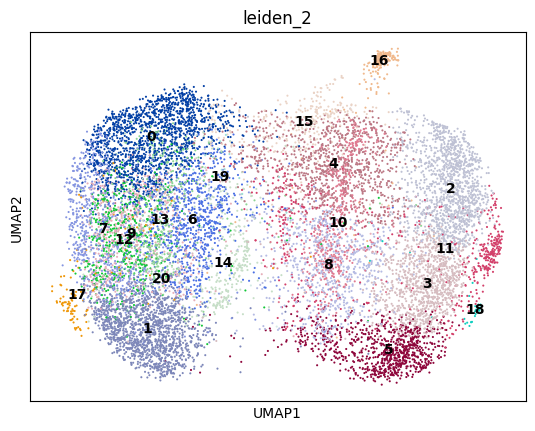

In [24]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

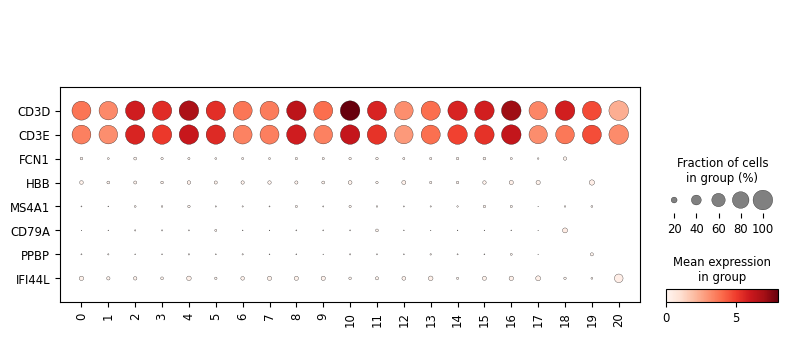

In [25]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

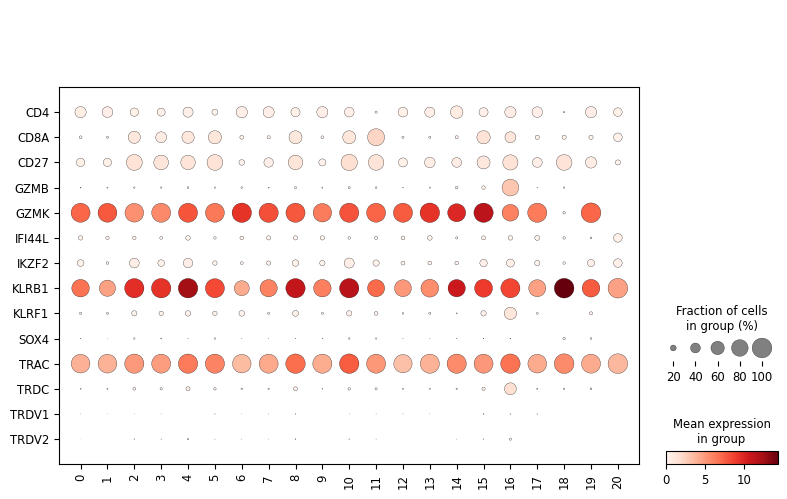

In [26]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Cluster counts

In [27]:
adata.obs['leiden_2'].value_counts()

leiden_2
0     1544
1     1485
2     1298
3     1030
4      944
5      895
6      855
7      772
8      743
9      607
10     540
11     530
12     499
13     412
14     360
15     327
16     195
17     114
18      31
19      23
20       6
Name: count, dtype: int64

### Outlier investigation

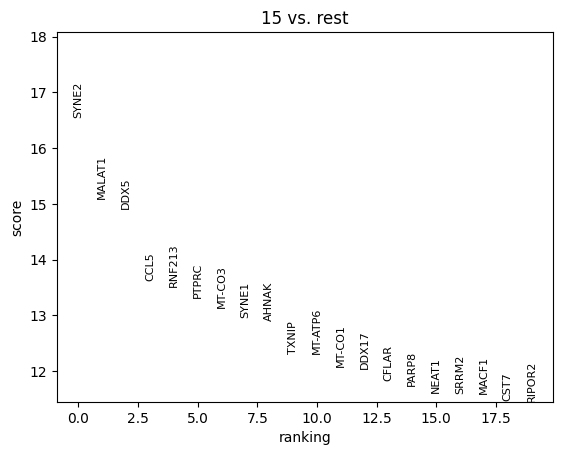

In [28]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['15']
)
sc.pl.rank_genes_groups(adata)

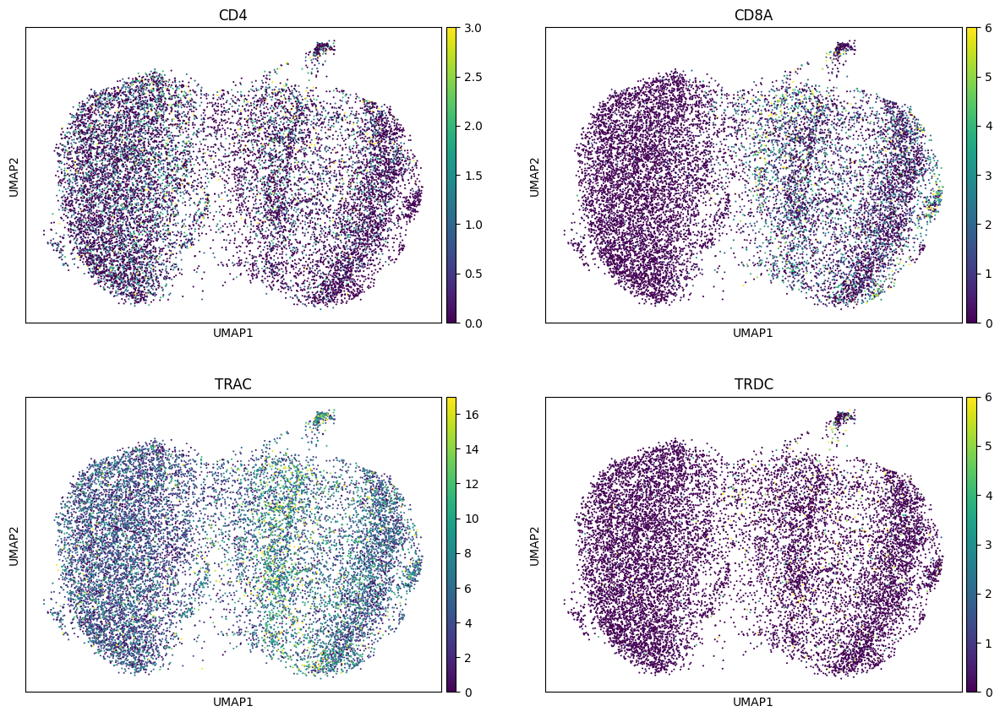

In [29]:
sc.pl.umap(adata, color = ['CD4','CD8A', 'TRAC', 'TRDC'], vmax = 'p99', ncols = 2)

### Comparison to original labels

In [30]:
adata = add_labels(adata, original_df)

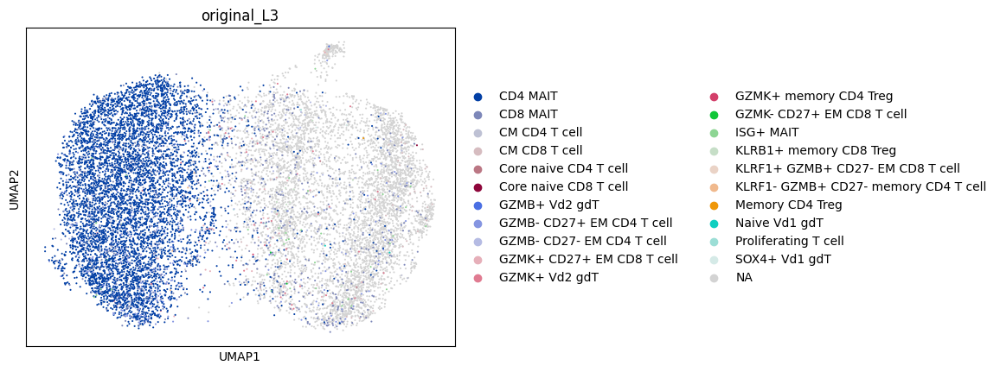

In [31]:
sc.pl.umap(adata, color = 'original_L3')

In [32]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
CD4 MAIT                                5848
NaN                                     5733
CD8 MAIT                                 900
GZMB- CD27+ EM CD4 T cell                378
GZMB- CD27- EM CD4 T cell                100
CM CD8 T cell                             62
GZMK+ Vd2 gdT                             58
ISG+ MAIT                                 44
GZMK+ CD27+ EM CD8 T cell                 40
KLRB1+ memory CD8 Treg                    16
KLRF1- GZMB+ CD27- memory CD4 T cell       7
CM CD4 T cell                              6
Proliferating T cell                       3
SOX4+ Vd1 gdT                              2
Naive Vd1 gdT                              2
GZMK- CD27+ EM CD8 T cell                  2
KLRF1+ GZMB+ CD27- EM CD8 T cell           2
GZMB+ Vd2 gdT                              2
Core naive CD4 T cell                      2
Memory CD4 Treg                            1
Core naive CD8 T cell                      1
GZMK+ memory CD4 Treg                      

In [33]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
CD4 MAIT                                0.442695
NaN                                     0.433989
CD8 MAIT                                0.068130
GZMB- CD27+ EM CD4 T cell               0.028615
GZMB- CD27- EM CD4 T cell               0.007570
CM CD8 T cell                           0.004693
GZMK+ Vd2 gdT                           0.004391
ISG+ MAIT                               0.003331
GZMK+ CD27+ EM CD8 T cell               0.003028
KLRB1+ memory CD8 Treg                  0.001211
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000530
CM CD4 T cell                           0.000454
Proliferating T cell                    0.000227
SOX4+ Vd1 gdT                           0.000151
Naive Vd1 gdT                           0.000151
GZMK- CD27+ EM CD8 T cell               0.000151
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000151
GZMB+ Vd2 gdT                           0.000151
Core naive CD4 T cell                   0.000151
Memory CD4 Treg                         0.000076
Core nai

### Proposed updates

- Reassign CD8A-high clusters as CD8 MAIT

## Review CD8 MAIT

In [34]:
cell_type = 'CD8 MAIT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [35]:
type_uuid

'1d6c5e1f-4e1b-4a9c-a104-650512fd27da'

In [36]:
adata = read_adata_uuid(type_uuid)

### Clustering

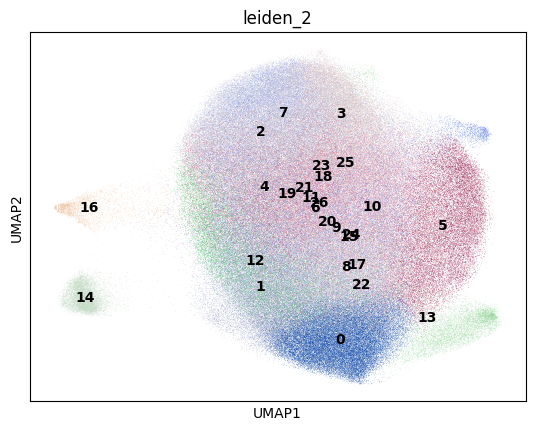

In [37]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

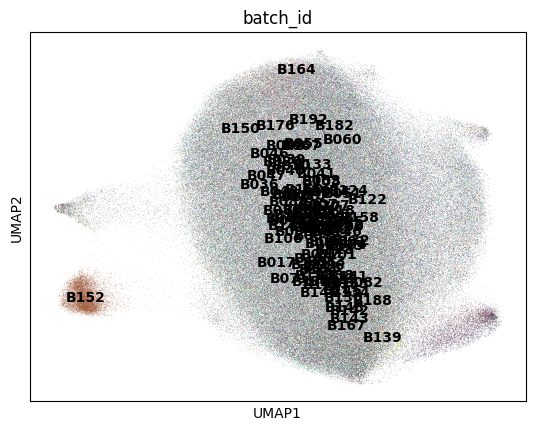

In [38]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

### Marker expression

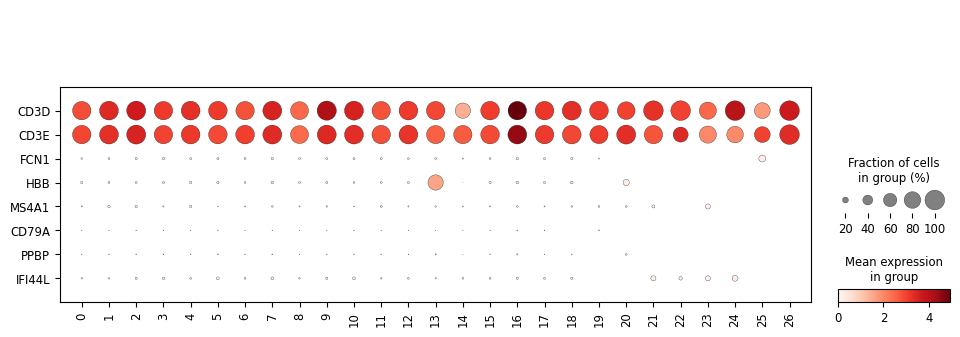

In [39]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

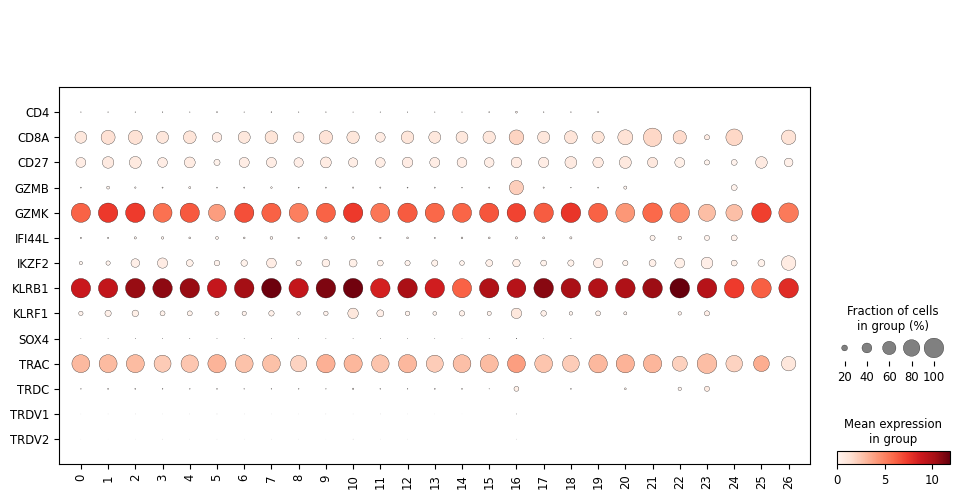

In [40]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

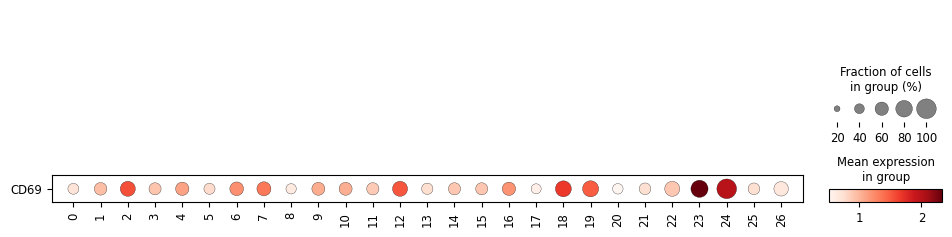

In [41]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = ['CD69'], swap_axes = True)

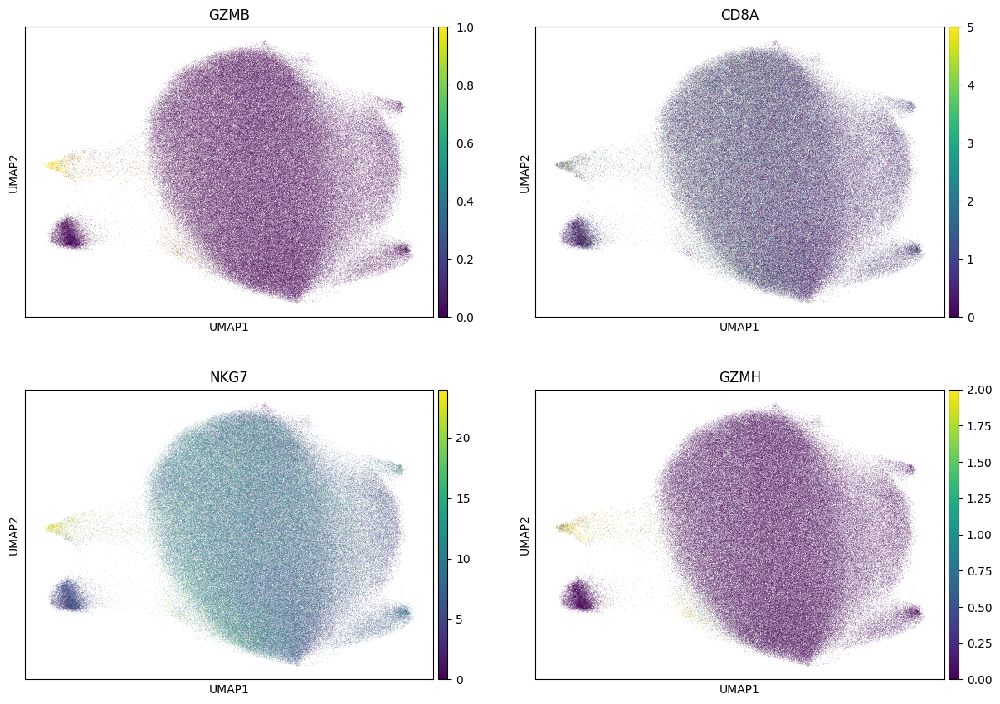

In [42]:
sc.pl.umap(adata, color = ['GZMB','CD8A', 'NKG7', 'GZMH'], vmax = 'p99', ncols = 2)

### Cluster counts

In [43]:
adata.obs['leiden_2'].value_counts()

leiden_2
0     39120
1     27897
2     27272
3     26779
4     26750
5     26184
6     24832
7     24342
8     22819
9     21924
10    18191
11    17811
12    14387
13    12003
14    10870
15     4578
16     3346
17      314
18      147
19       51
20       23
21       12
22       10
23        6
24        5
25        4
26        3
Name: count, dtype: int64

### Investigate outliers

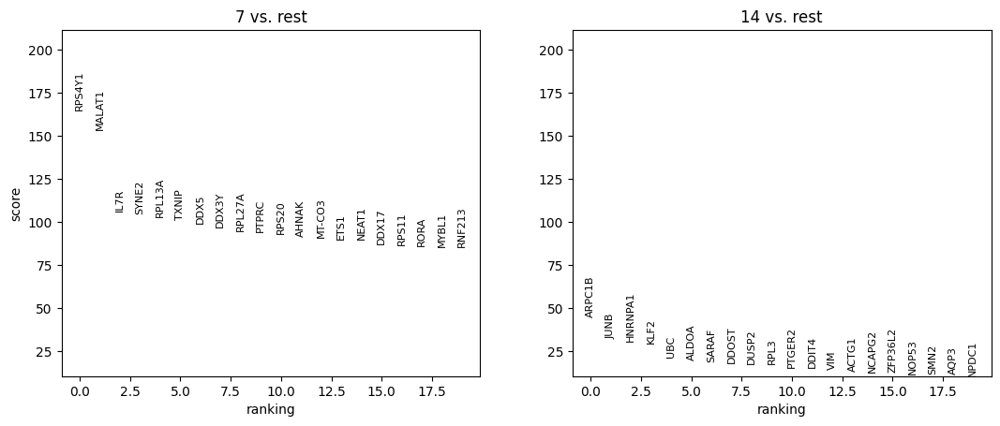

In [44]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['7','14']
)
sc.pl.rank_genes_groups(adata)

### Comparison to original labels

In [45]:
adata = add_labels(adata, original_df)

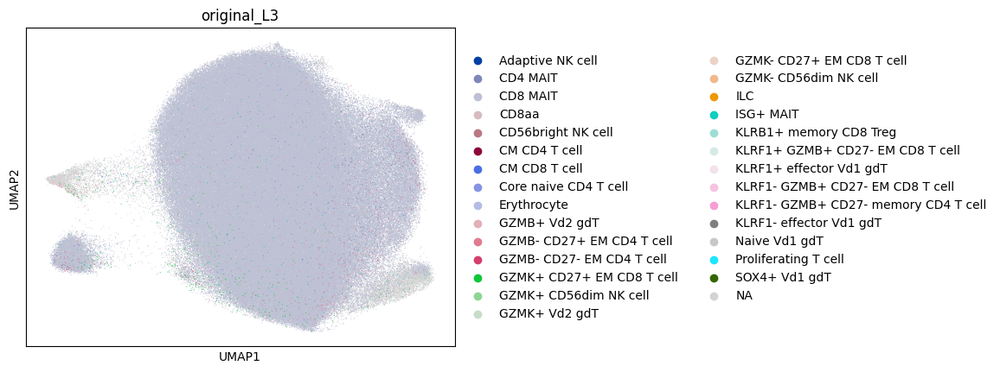

In [46]:
sc.pl.umap(adata, color = 'original_L3', size = 2)

In [47]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
CD8 MAIT                                323855
NaN                                      18689
CD4 MAIT                                  2152
GZMK+ Vd2 gdT                             1776
GZMB- CD27+ EM CD4 T cell                 1122
ISG+ MAIT                                  892
GZMK+ CD27+ EM CD8 T cell                  601
GZMB- CD27- EM CD4 T cell                  118
KLRF1- GZMB+ CD27- memory CD4 T cell        96
KLRF1- GZMB+ CD27- EM CD8 T cell            94
CM CD8 T cell                               72
GZMB+ Vd2 gdT                               57
GZMK- CD27+ EM CD8 T cell                   41
GZMK+ CD56dim NK cell                       32
KLRF1+ GZMB+ CD27- EM CD8 T cell            28
Proliferating T cell                        10
Erythrocyte                                  9
GZMK- CD56dim NK cell                        8
CM CD4 T cell                                5
CD8aa                                        5
KLRF1+ effector Vd1 gdT                      4
N

In [48]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
CD8 MAIT                                0.926147
NaN                                     0.053446
CD4 MAIT                                0.006154
GZMK+ Vd2 gdT                           0.005079
GZMB- CD27+ EM CD4 T cell               0.003209
ISG+ MAIT                               0.002551
GZMK+ CD27+ EM CD8 T cell               0.001719
GZMB- CD27- EM CD4 T cell               0.000337
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000275
KLRF1- GZMB+ CD27- EM CD8 T cell        0.000269
CM CD8 T cell                           0.000206
GZMB+ Vd2 gdT                           0.000163
GZMK- CD27+ EM CD8 T cell               0.000117
GZMK+ CD56dim NK cell                   0.000092
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000080
Proliferating T cell                    0.000029
Erythrocyte                             0.000026
GZMK- CD56dim NK cell                   0.000023
CM CD4 T cell                           0.000014
CD8aa                                   0.000014
KLRF1+ e

### Proposed updates

- Remove GZMH-high clusters as mislabeled
- Remove HBB+ cluster as Erythrocyte doublet

## Review ISG+ MAIT

In [49]:
cell_type = 'ISG+ MAIT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [50]:
type_uuid

'be52d937-6d53-4ca3-88f3-5741130bb389'

In [51]:
adata = read_adata_uuid(type_uuid)

### Clustering

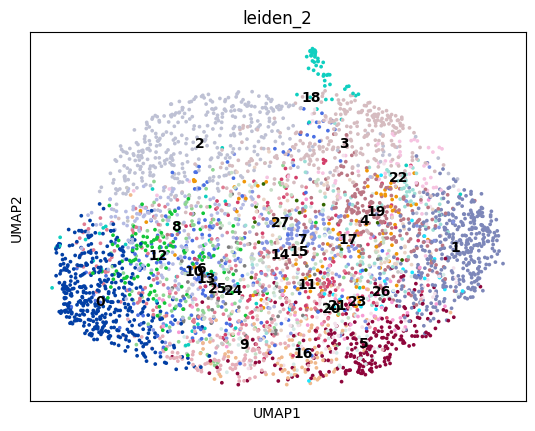

In [52]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

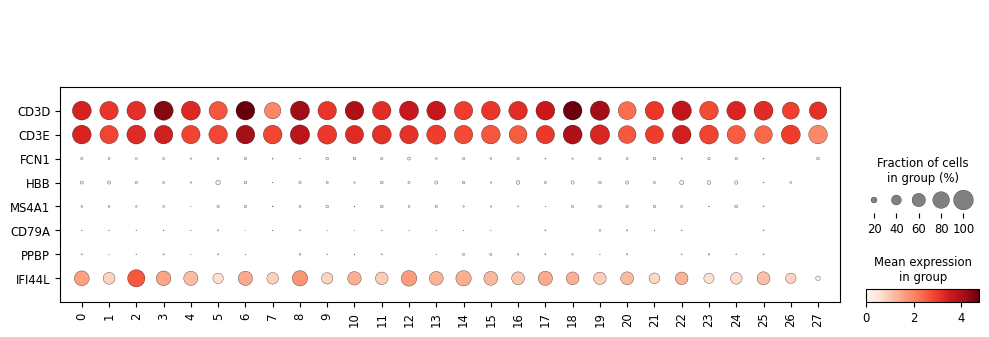

In [53]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

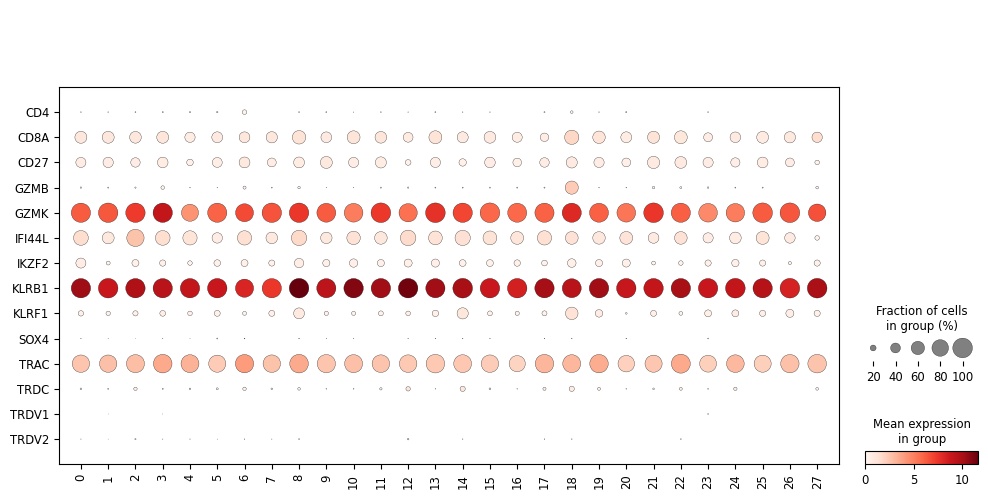

In [54]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Cluster counts

In [55]:
adata.obs['leiden_2'].value_counts()

leiden_2
0     430
1     411
2     374
3     299
4     257
5     251
6     202
7     161
8     158
9     152
10    144
11    132
12    109
13    101
14     99
15     97
16     93
17     92
18     87
19     86
20     79
21     78
22     63
23     60
24     52
25     47
26     23
27     14
Name: count, dtype: int64

### Comparison to original labels

In [56]:
adata = add_labels(adata, original_df)

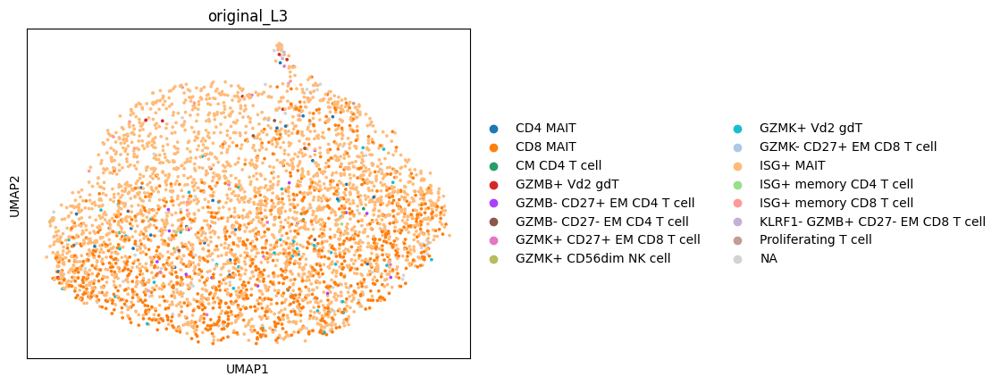

In [57]:
sc.pl.umap(adata, color = 'original_L3')

In [58]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
ISG+ MAIT                           2854
CD8 MAIT                            1032
NaN                                  121
GZMK+ Vd2 gdT                         44
CD4 MAIT                              27
GZMB- CD27+ EM CD4 T cell             16
GZMK+ CD27+ EM CD8 T cell             12
ISG+ memory CD8 T cell                12
GZMB+ Vd2 gdT                         11
GZMB- CD27- EM CD4 T cell              7
KLRF1- GZMB+ CD27- EM CD8 T cell       5
GZMK+ CD56dim NK cell                  3
GZMK- CD27+ EM CD8 T cell              3
ISG+ memory CD4 T cell                 2
CM CD4 T cell                          1
Proliferating T cell                   1
Name: count, dtype: int64

In [59]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
ISG+ MAIT                           0.687545
CD8 MAIT                            0.248615
NaN                                 0.029150
GZMK+ Vd2 gdT                       0.010600
CD4 MAIT                            0.006504
GZMB- CD27+ EM CD4 T cell           0.003854
GZMK+ CD27+ EM CD8 T cell           0.002891
ISG+ memory CD8 T cell              0.002891
GZMB+ Vd2 gdT                       0.002650
GZMB- CD27- EM CD4 T cell           0.001686
KLRF1- GZMB+ CD27- EM CD8 T cell    0.001205
GZMK+ CD56dim NK cell               0.000723
GZMK- CD27+ EM CD8 T cell           0.000723
ISG+ memory CD4 T cell              0.000482
CM CD4 T cell                       0.000241
Proliferating T cell                0.000241
Name: count, dtype: float64

### Proposed updates

No proposed changes

## Review DN T cell

In [60]:
cell_type = 'DN T cell'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [61]:
type_uuid

'9bf54fcf-d768-4a40-a9a4-698606417008'

In [62]:
adata = read_adata_uuid(type_uuid)

### Clustering

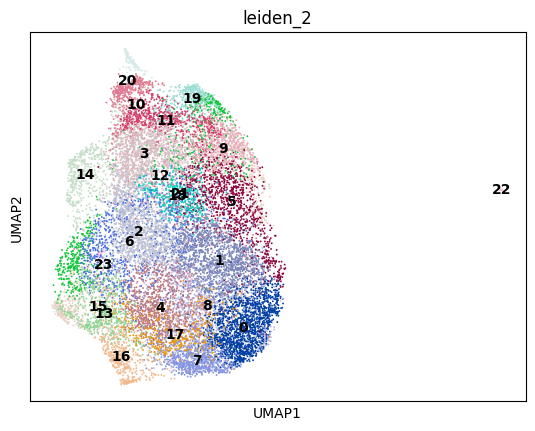

In [63]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

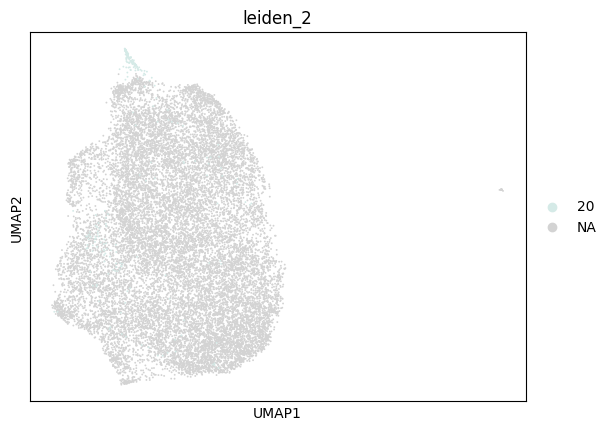

In [64]:
sc.pl.umap(adata, color = 'leiden_2', groups = '20')

### Marker expression

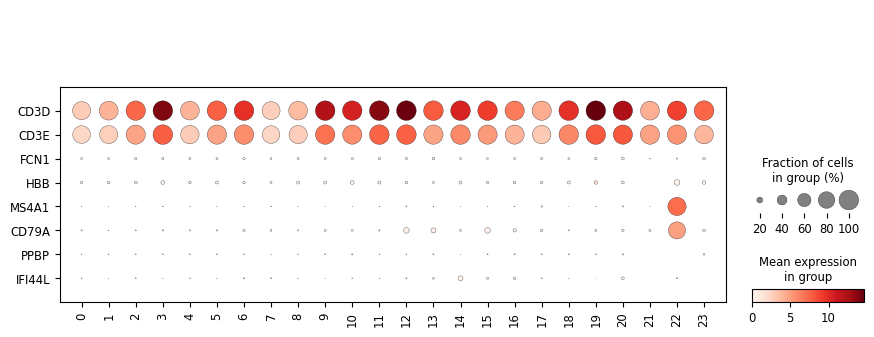

In [65]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

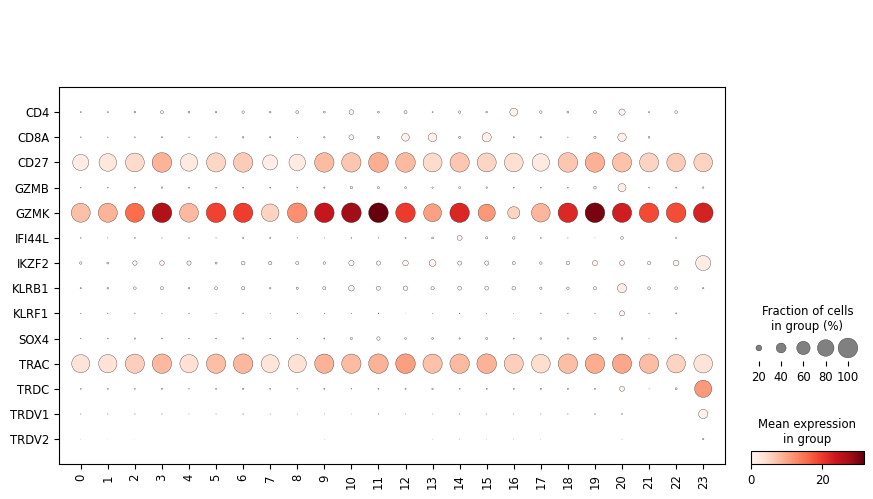

In [66]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

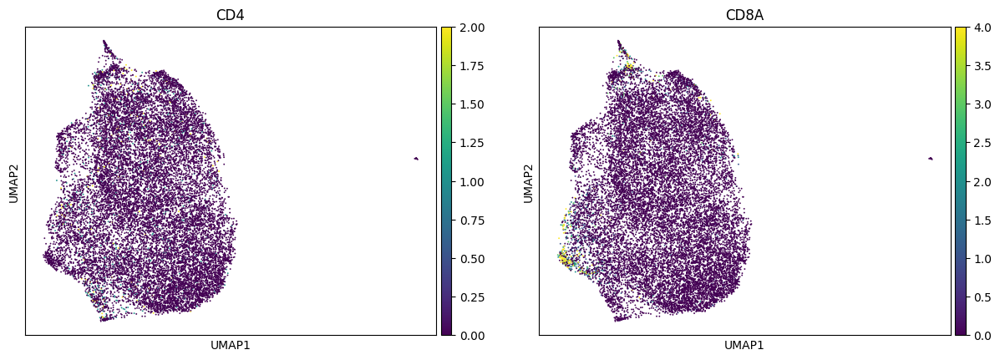

In [67]:
sc.pl.umap(adata, color = ['CD4','CD8A'], vmax = 'p99')

### Comparison to original labels

In [68]:
adata = add_labels(adata, original_df)

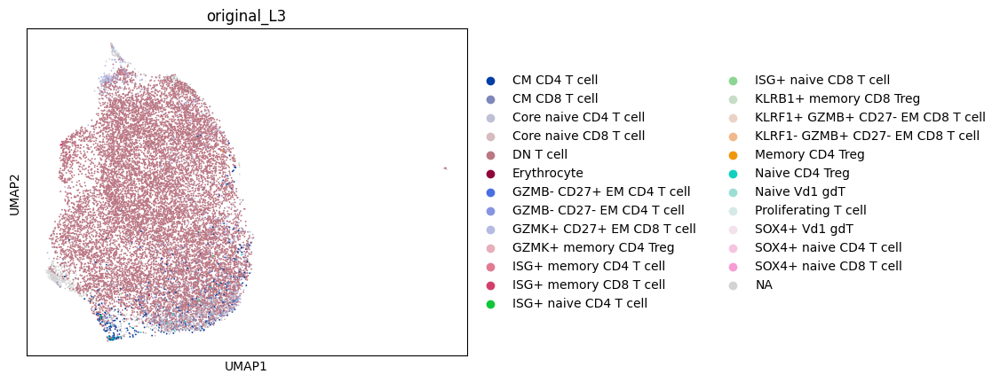

In [69]:
sc.pl.umap(adata, color = 'original_L3')

In [70]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
DN T cell                           14255
NaN                                   637
GZMK+ CD27+ EM CD8 T cell             433
CM CD4 T cell                         363
Core naive CD4 T cell                 356
CM CD8 T cell                         340
Core naive CD8 T cell                 203
Proliferating T cell                   75
Naive CD4 Treg                         24
GZMK+ memory CD4 Treg                  20
GZMB- CD27+ EM CD4 T cell              15
ISG+ memory CD8 T cell                 15
Naive Vd1 gdT                          14
SOX4+ naive CD4 T cell                  9
SOX4+ Vd1 gdT                           7
ISG+ naive CD4 T cell                   7
Memory CD4 Treg                         3
KLRF1+ GZMB+ CD27- EM CD8 T cell        3
Erythrocyte                             3
ISG+ memory CD4 T cell                  3
GZMB- CD27- EM CD4 T cell               3
KLRF1- GZMB+ CD27- EM CD8 T cell        1
ISG+ naive CD8 T cell                   1
SOX4+ naive CD8 T cell

In [71]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
DN T cell                           0.848916
NaN                                 0.037935
GZMK+ CD27+ EM CD8 T cell           0.025786
CM CD4 T cell                       0.021617
Core naive CD4 T cell               0.021201
CM CD8 T cell                       0.020248
Core naive CD8 T cell               0.012089
Proliferating T cell                0.004466
Naive CD4 Treg                      0.001429
GZMK+ memory CD4 Treg               0.001191
GZMB- CD27+ EM CD4 T cell           0.000893
ISG+ memory CD8 T cell              0.000893
Naive Vd1 gdT                       0.000834
SOX4+ naive CD4 T cell              0.000536
SOX4+ Vd1 gdT                       0.000417
ISG+ naive CD4 T cell               0.000417
Memory CD4 Treg                     0.000179
KLRF1+ GZMB+ CD27- EM CD8 T cell    0.000179
Erythrocyte                         0.000179
ISG+ memory CD4 T cell              0.000179
GZMB- CD27- EM CD4 T cell           0.000179
KLRF1- GZMB+ CD27- EM CD8 T cell    0.00006

### Proposed updates

- Remove MS4A1+ cluster as B cell doublets
- Remove TRDC+ clusters as abT/gdT doublet

# Treg

## Review GZMK+ memory CD4 Treg

In [72]:
cell_type = 'GZMK+ memory CD4 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [73]:
type_uuid

'08d67bd2-261d-40a6-8f5f-f89b258e5d1d'

In [74]:
adata = read_adata_uuid(type_uuid)

### Clustering

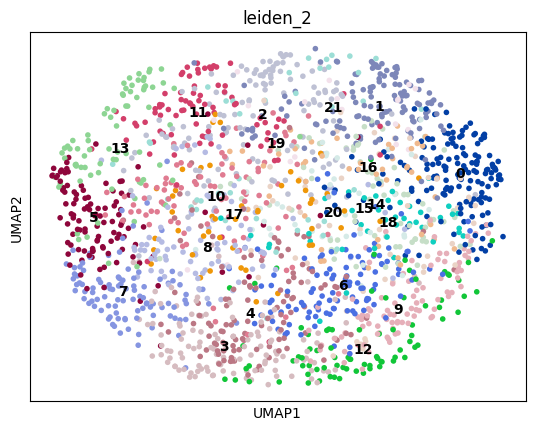

In [75]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

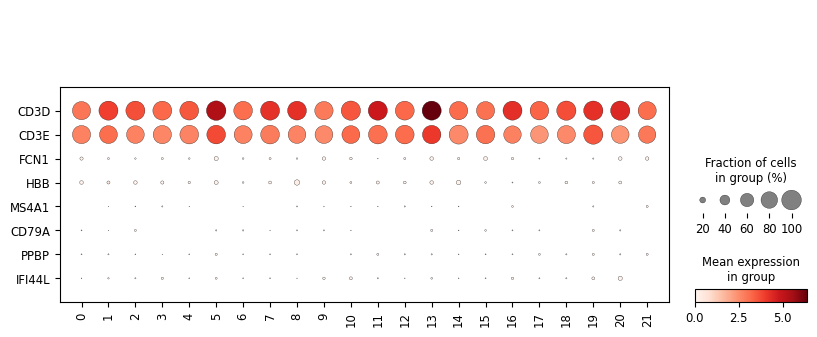

In [76]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

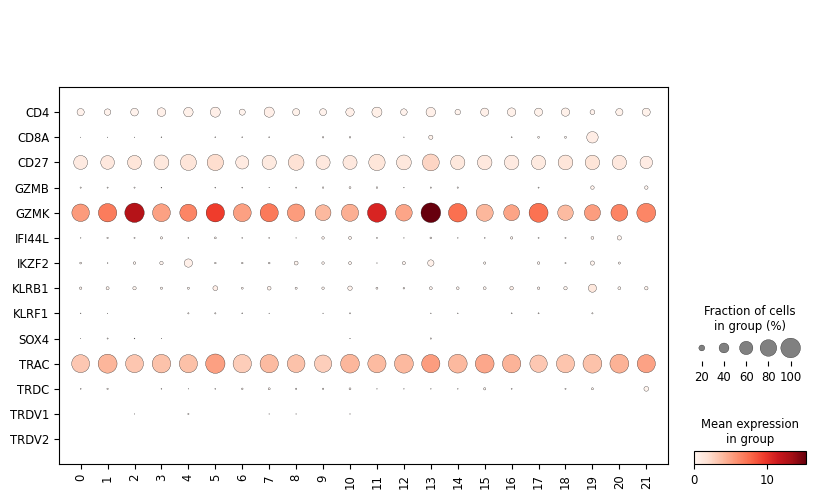

In [77]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

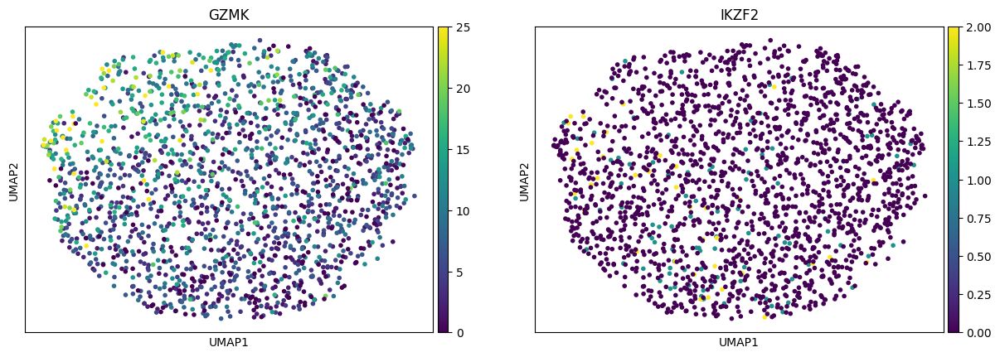

In [78]:
sc.pl.umap(adata, color = ['GZMK','IKZF2'], vmax = 'p99')

### Comparison to original labels

In [79]:
adata = add_labels(adata, original_df)

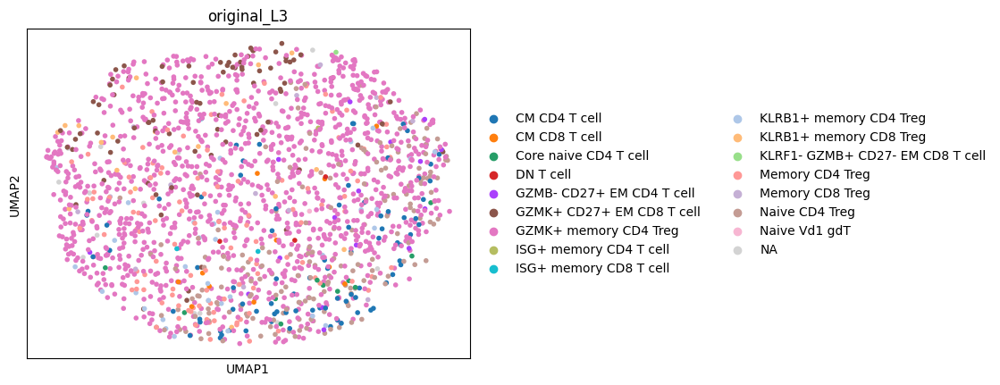

In [80]:
sc.pl.umap(adata, color = 'original_L3')

In [81]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
GZMK+ memory CD4 Treg               1247
Naive CD4 Treg                       184
Memory CD4 Treg                      115
CM CD4 T cell                         83
GZMK+ CD27+ EM CD8 T cell             81
KLRB1+ memory CD4 Treg                32
KLRB1+ memory CD8 Treg                20
GZMB- CD27+ EM CD4 T cell             16
NaN                                   15
Memory CD8 Treg                       13
CM CD8 T cell                         11
Core naive CD4 T cell                 11
DN T cell                              3
ISG+ memory CD8 T cell                 3
ISG+ memory CD4 T cell                 1
KLRF1- GZMB+ CD27- EM CD8 T cell       1
Naive Vd1 gdT                          1
Name: count, dtype: int64

In [82]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
GZMK+ memory CD4 Treg               0.678824
Naive CD4 Treg                      0.100163
Memory CD4 Treg                     0.062602
CM CD4 T cell                       0.045182
GZMK+ CD27+ EM CD8 T cell           0.044094
KLRB1+ memory CD4 Treg              0.017420
KLRB1+ memory CD8 Treg              0.010887
GZMB- CD27+ EM CD4 T cell           0.008710
NaN                                 0.008165
Memory CD8 Treg                     0.007077
CM CD8 T cell                       0.005988
Core naive CD4 T cell               0.005988
DN T cell                           0.001633
ISG+ memory CD8 T cell              0.001633
ISG+ memory CD4 T cell              0.000544
KLRF1- GZMB+ CD27- EM CD8 T cell    0.000544
Naive Vd1 gdT                       0.000544
Name: count, dtype: float64

### Proposed updates

No proposed changes

## Review KLRB1+ memory CD4 Treg

In [83]:
cell_type = 'KLRB1+ memory CD4 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [84]:
type_uuid

'5da8e0ae-eb35-4e52-b123-1a1d8734abc8'

In [85]:
adata = read_adata_uuid(type_uuid)

### Clustering

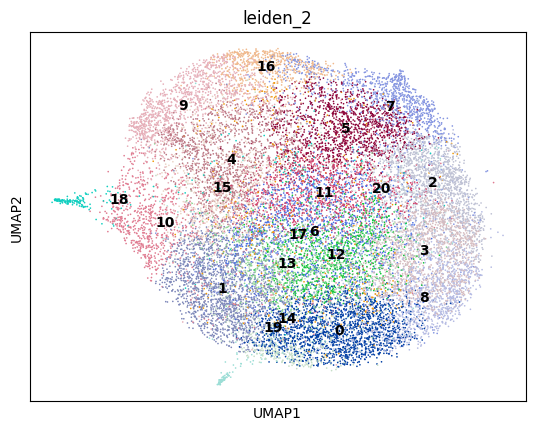

In [86]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

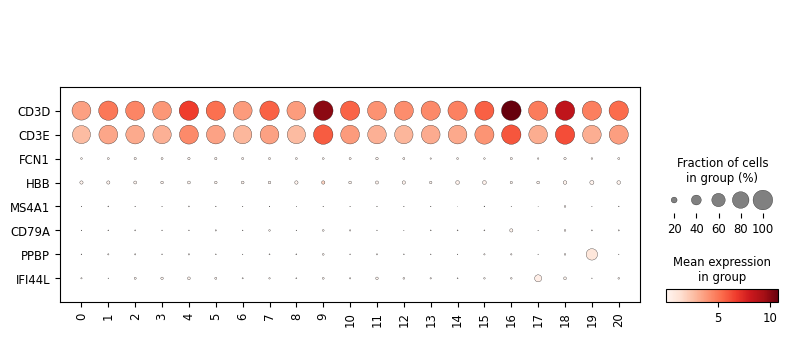

In [87]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

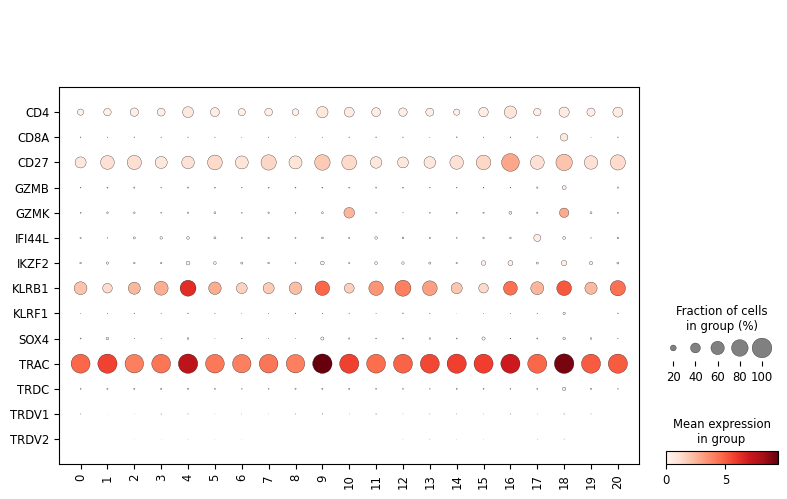

In [88]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

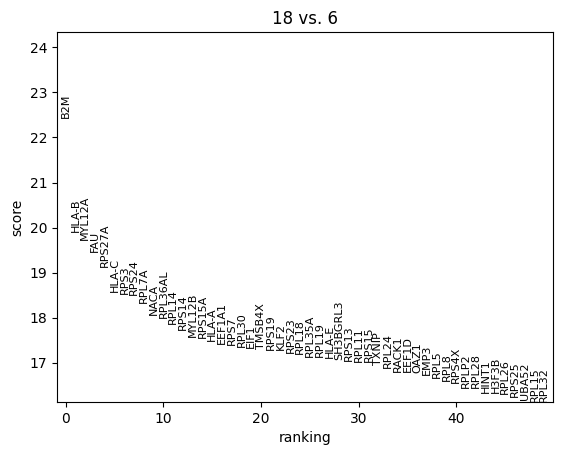

In [89]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['18'],
    reference = '6'
)
sc.pl.rank_genes_groups(adata, n_genes = 50)

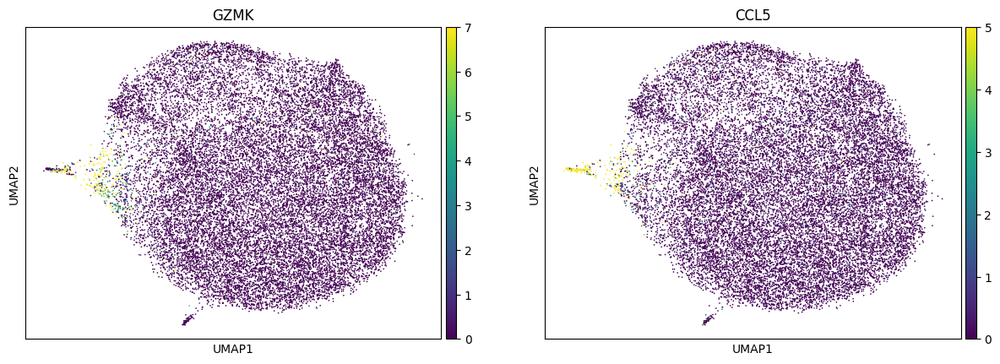

In [90]:
sc.pl.umap(adata, color = ['GZMK','CCL5'], vmax = 'p99')

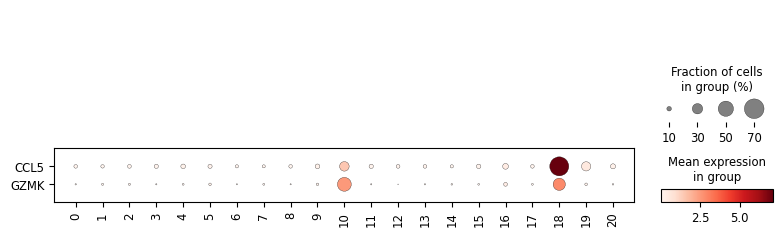

In [91]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = ['CCL5','GZMK'], swap_axes = True)

### Comparison to original labels

In [92]:
adata = add_labels(adata, original_df)

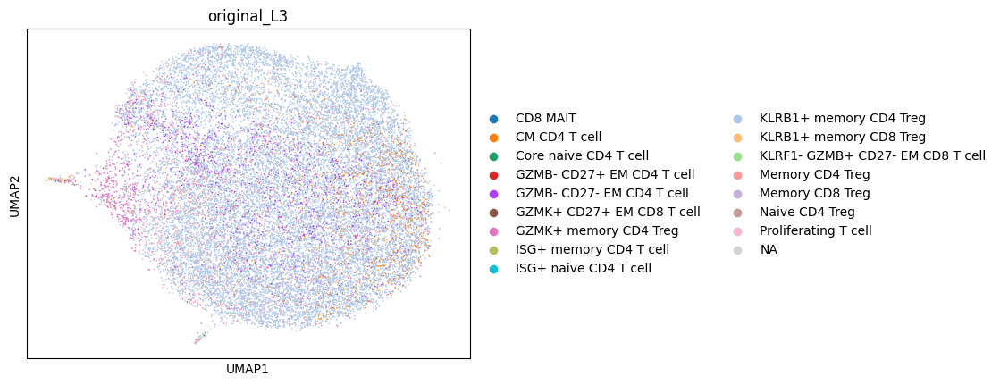

In [93]:
sc.pl.umap(adata, color = 'original_L3')

In [94]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
KLRB1+ memory CD4 Treg              16759
Memory CD4 Treg                      1248
GZMB- CD27- EM CD4 T cell            1020
GZMK+ memory CD4 Treg                 710
CM CD4 T cell                         668
NaN                                   235
Naive CD4 Treg                        193
KLRB1+ memory CD8 Treg                 24
Proliferating T cell                   18
Memory CD8 Treg                        17
Core naive CD4 T cell                  14
ISG+ memory CD4 T cell                 14
GZMK+ CD27+ EM CD8 T cell              10
GZMB- CD27+ EM CD4 T cell               7
CD8 MAIT                                2
KLRF1- GZMB+ CD27- EM CD8 T cell        2
ISG+ naive CD4 T cell                   1
Name: count, dtype: int64

In [95]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
KLRB1+ memory CD4 Treg              0.800258
Memory CD4 Treg                     0.059593
GZMB- CD27- EM CD4 T cell           0.048706
GZMK+ memory CD4 Treg               0.033903
CM CD4 T cell                       0.031898
NaN                                 0.011221
Naive CD4 Treg                      0.009216
KLRB1+ memory CD8 Treg              0.001146
Proliferating T cell                0.000860
Memory CD8 Treg                     0.000812
Core naive CD4 T cell               0.000669
ISG+ memory CD4 T cell              0.000669
GZMK+ CD27+ EM CD8 T cell           0.000478
GZMB- CD27+ EM CD4 T cell           0.000334
CD8 MAIT                            0.000096
KLRF1- GZMB+ CD27- EM CD8 T cell    0.000096
ISG+ naive CD4 T cell               0.000048
Name: count, dtype: float64

### Proposed updates

- Reassign GZMK-high cluster as GZMK+ memory CD4 Treg
- Remove CCL5-high cluster as mislabeled

## Review KLRB1+ memory CD8 Treg

In [96]:
cell_type = 'KLRB1+ memory CD8 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [97]:
type_uuid

'85a50dcb-af01-4288-8273-4f06b0e36c43'

In [98]:
adata = read_adata_uuid(type_uuid)

### Clustering

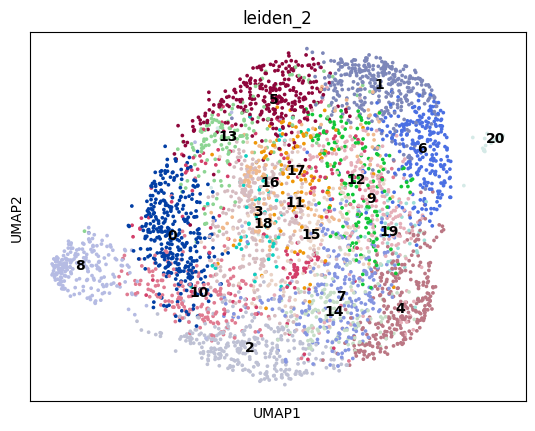

In [99]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

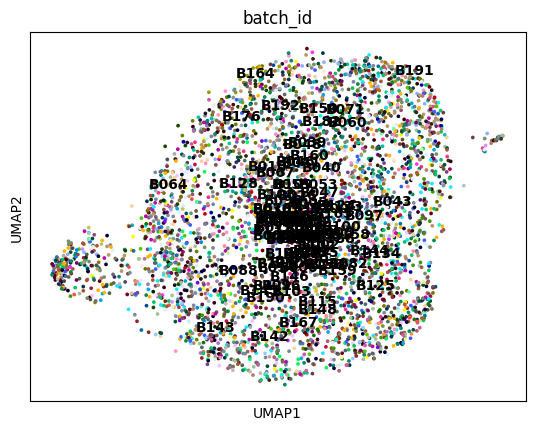

In [100]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

### Marker expression

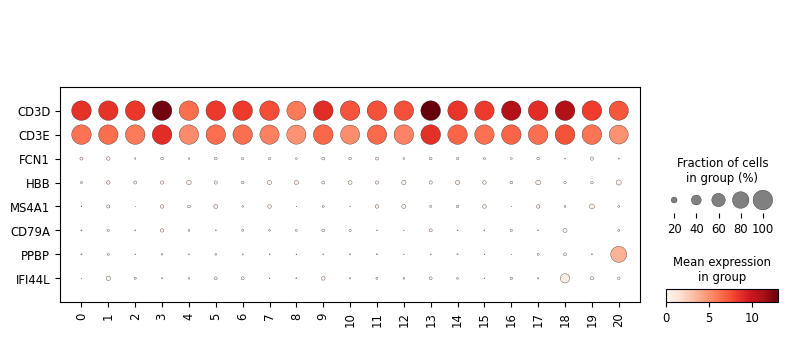

In [101]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

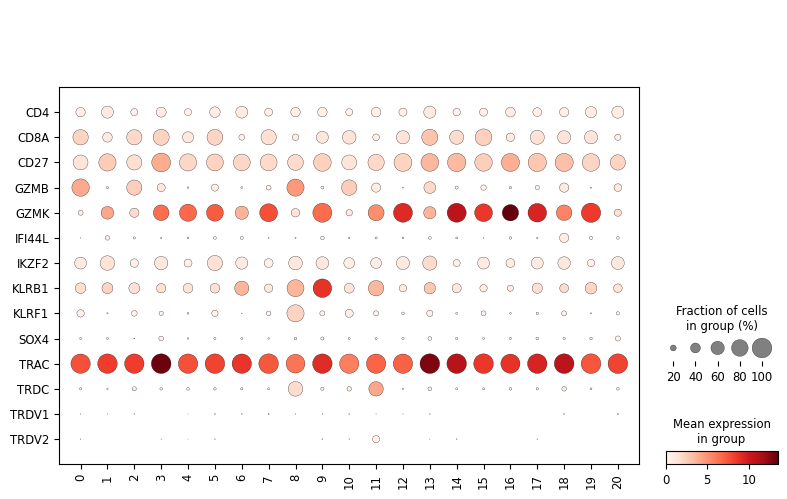

In [102]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

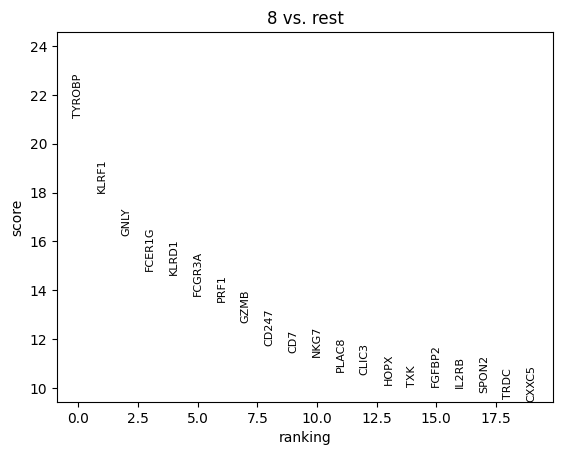

In [103]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['8']
)
sc.pl.rank_genes_groups(adata, ncols = 2)

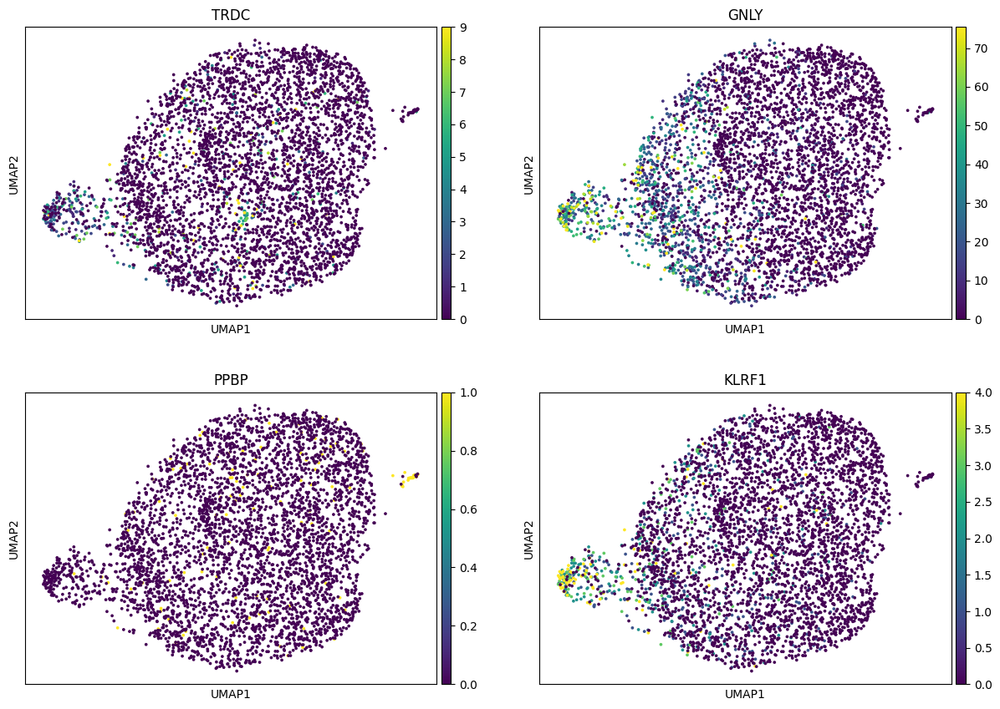

In [104]:
sc.pl.umap(adata, color = ['TRDC','GNLY','PPBP','KLRF1'], vmax = 'p99', ncols = 2)

### Comparison to original labels

In [105]:
adata = add_labels(adata, original_df)

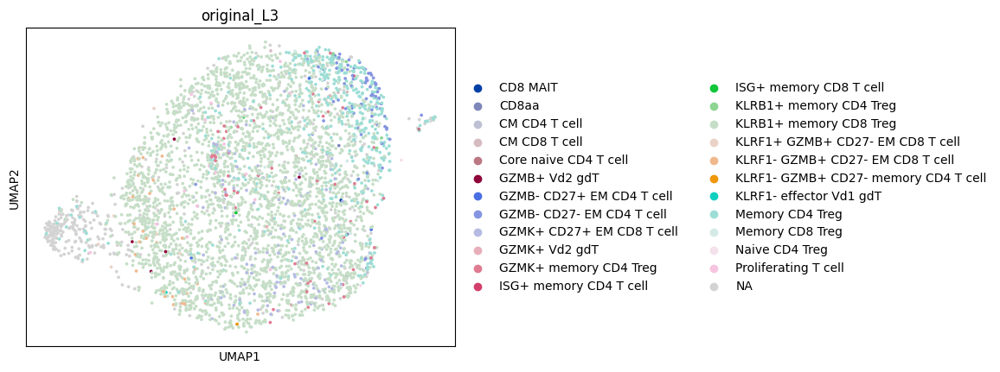

In [106]:
sc.pl.umap(adata, color = 'original_L3')

In [107]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
KLRB1+ memory CD8 Treg                  2815
NaN                                      477
Memory CD4 Treg                          457
GZMK+ CD27+ EM CD8 T cell                151
GZMB- CD27- EM CD4 T cell                 83
GZMK+ memory CD4 Treg                     64
KLRF1- GZMB+ CD27- EM CD8 T cell          31
Memory CD8 Treg                           19
Proliferating T cell                      16
KLRF1+ GZMB+ CD27- EM CD8 T cell           8
CM CD8 T cell                              5
GZMB+ Vd2 gdT                              5
KLRB1+ memory CD4 Treg                     5
GZMB- CD27+ EM CD4 T cell                  4
Naive CD4 Treg                             3
ISG+ memory CD8 T cell                     2
CD8aa                                      2
GZMK+ Vd2 gdT                              2
CM CD4 T cell                              2
KLRF1- GZMB+ CD27- memory CD4 T cell       1
KLRF1- effector Vd1 gdT                    1
ISG+ memory CD4 T cell                     

In [108]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
KLRB1+ memory CD8 Treg                  0.677334
NaN                                     0.114774
Memory CD4 Treg                         0.109962
GZMK+ CD27+ EM CD8 T cell               0.036333
GZMB- CD27- EM CD4 T cell               0.019971
GZMK+ memory CD4 Treg                   0.015399
KLRF1- GZMB+ CD27- EM CD8 T cell        0.007459
Memory CD8 Treg                         0.004572
Proliferating T cell                    0.003850
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.001925
CM CD8 T cell                           0.001203
GZMB+ Vd2 gdT                           0.001203
KLRB1+ memory CD4 Treg                  0.001203
GZMB- CD27+ EM CD4 T cell               0.000962
Naive CD4 Treg                          0.000722
ISG+ memory CD8 T cell                  0.000481
CD8aa                                   0.000481
GZMK+ Vd2 gdT                           0.000481
CM CD4 T cell                           0.000481
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000241
KLRF1- e

### Proposed updates

- Remove GNLY-high cluster as mislabeled
- Remove PPBP-high cluster as Platelet doublets

## Review Memory CD4 Treg

In [109]:
cell_type = 'Memory CD4 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [110]:
type_uuid

'59959bb2-b20a-4d1b-acb5-5a048ed3986f'

In [111]:
adata = read_adata_uuid(type_uuid)

### Clustering

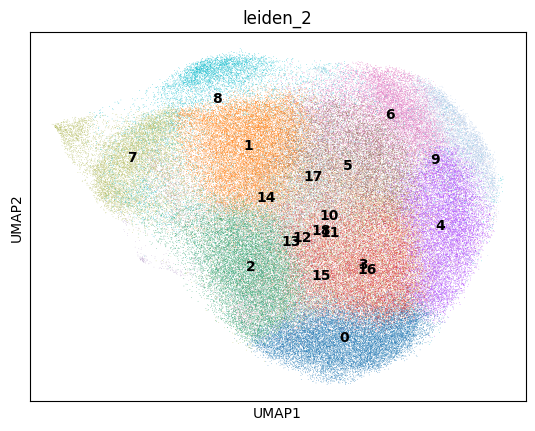

In [112]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

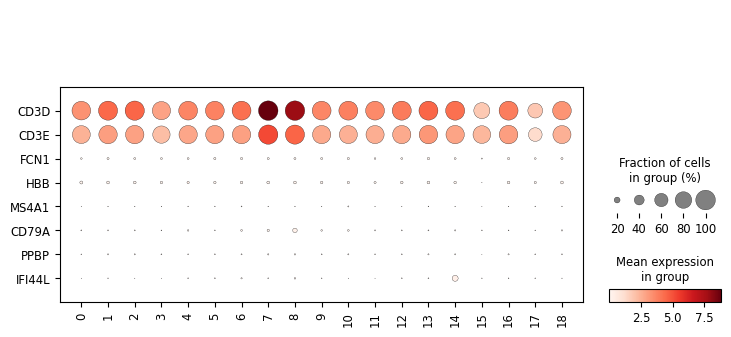

In [113]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

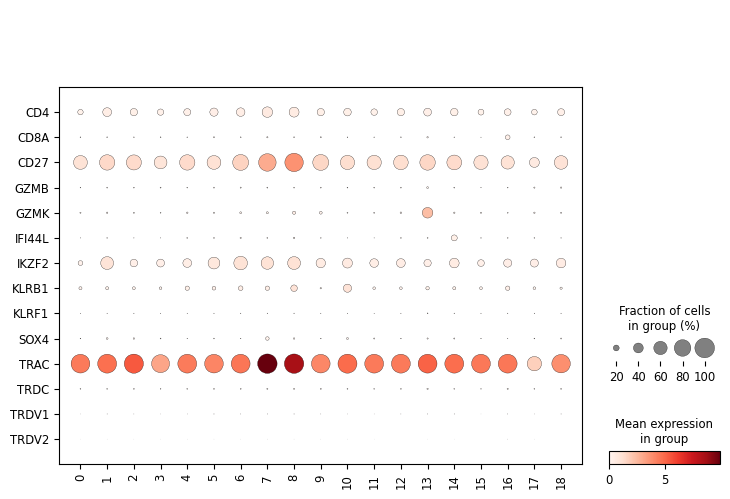

In [114]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

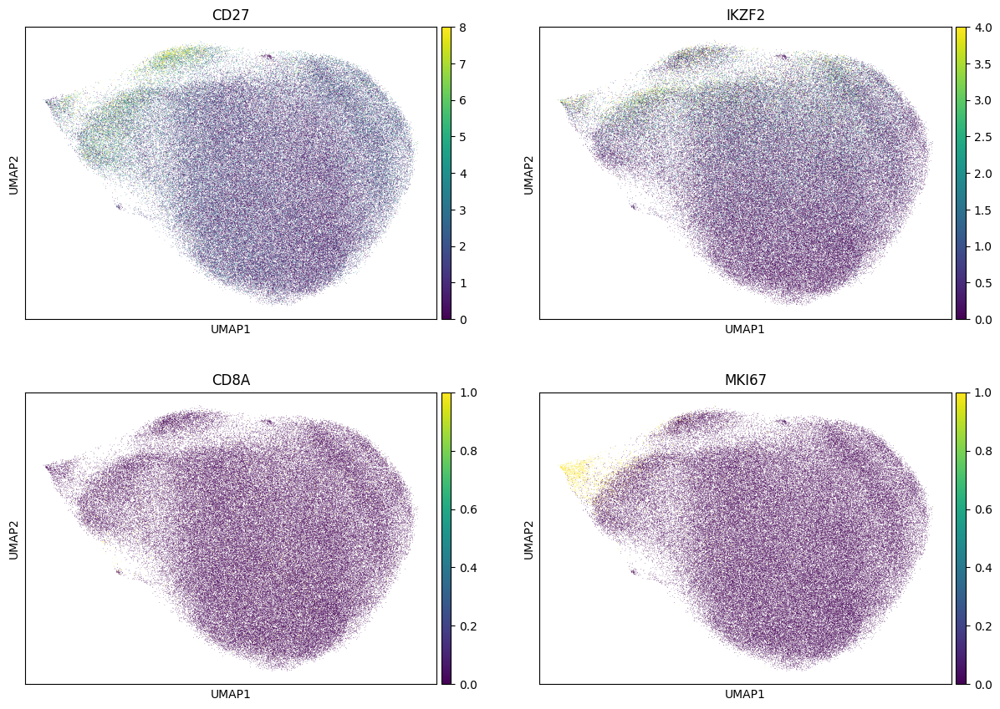

In [115]:
sc.pl.umap(adata, color = ['CD27','IKZF2','CD8A','MKI67'], vmax = 'p99', ncols = 2)

### Comparison to original labels

In [116]:
adata = add_labels(adata, original_df)

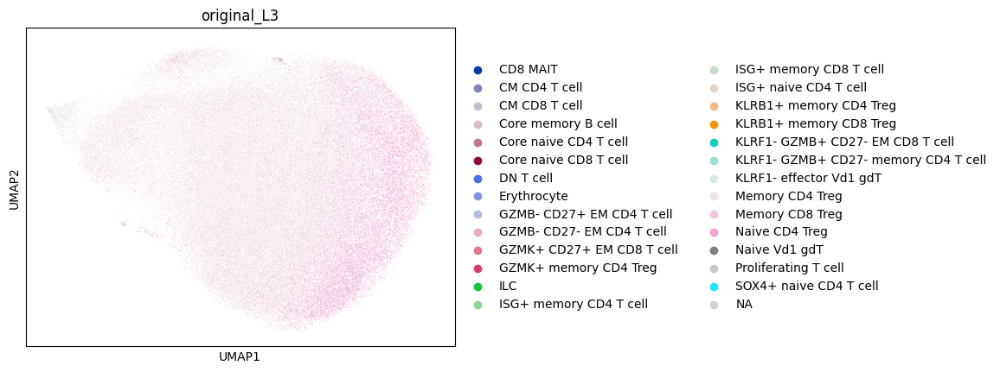

In [117]:
sc.pl.umap(adata, color = 'original_L3')

In [118]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Memory CD4 Treg                         118495
Naive CD4 Treg                           17957
CM CD4 T cell                             2084
KLRB1+ memory CD4 Treg                    1691
GZMK+ memory CD4 Treg                      925
GZMB- CD27- EM CD4 T cell                  807
NaN                                        744
Proliferating T cell                       330
Memory CD8 Treg                            299
Core naive CD4 T cell                      103
KLRB1+ memory CD8 Treg                      74
ISG+ memory CD4 T cell                      49
GZMK+ CD27+ EM CD8 T cell                   44
GZMB- CD27+ EM CD4 T cell                   17
Erythrocyte                                  8
CM CD8 T cell                                8
SOX4+ naive CD4 T cell                       3
ISG+ naive CD4 T cell                        3
CD8 MAIT                                     2
KLRF1- GZMB+ CD27- memory CD4 T cell         1
KLRF1- effector Vd1 gdT                      1
K

In [119]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Memory CD4 Treg                         0.824875
Naive CD4 Treg                          0.125003
CM CD4 T cell                           0.014507
KLRB1+ memory CD4 Treg                  0.011772
GZMK+ memory CD4 Treg                   0.006439
GZMB- CD27- EM CD4 T cell               0.005618
NaN                                     0.005179
Proliferating T cell                    0.002297
Memory CD8 Treg                         0.002081
Core naive CD4 T cell                   0.000717
KLRB1+ memory CD8 Treg                  0.000515
ISG+ memory CD4 T cell                  0.000341
GZMK+ CD27+ EM CD8 T cell               0.000306
GZMB- CD27+ EM CD4 T cell               0.000118
Erythrocyte                             0.000056
CM CD8 T cell                           0.000056
SOX4+ naive CD4 T cell                  0.000021
ISG+ naive CD4 T cell                   0.000021
CD8 MAIT                                0.000014
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000007
KLRF1- e

### Proposed updates

- Reassign MKI67-high cluster to Proliferating T cell

## Review Memory CD8 Treg

In [120]:
cell_type = 'Memory CD8 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [121]:
type_uuid

'bc8acf20-7748-4107-9912-c3fcfe8929a3'

In [122]:
adata = read_adata_uuid(type_uuid)

### Clustering

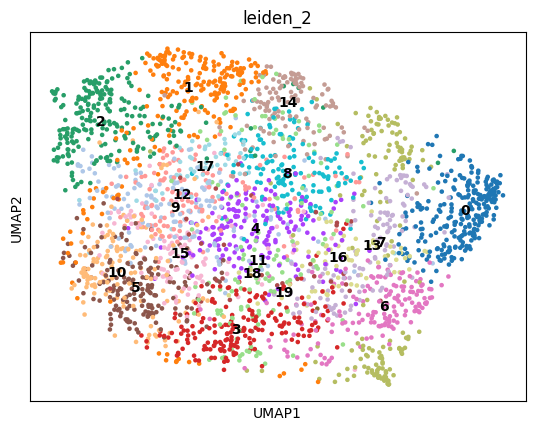

In [123]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

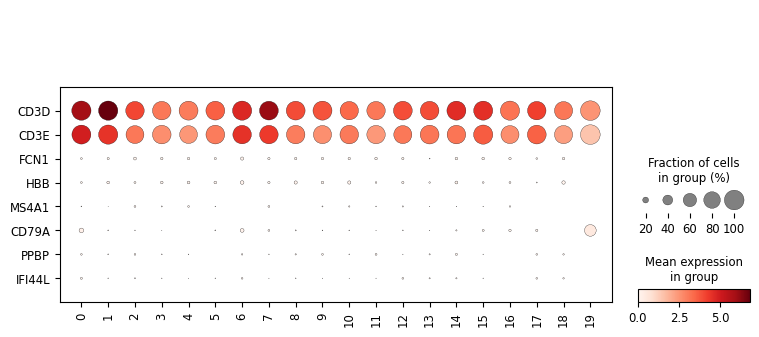

In [124]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

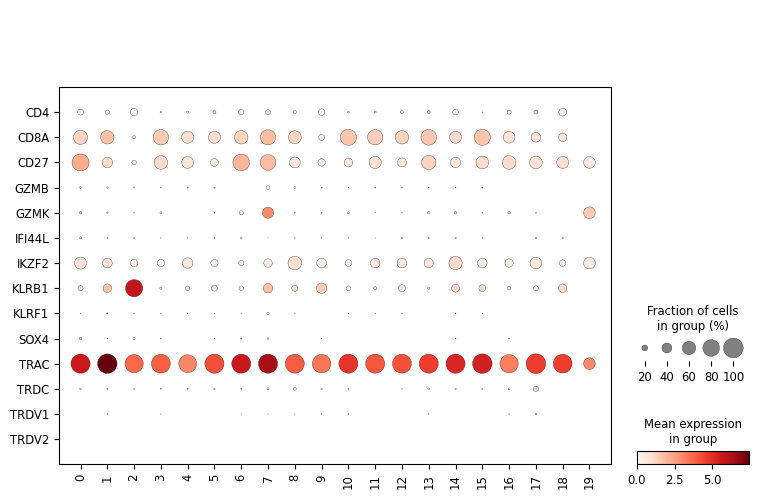

In [125]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

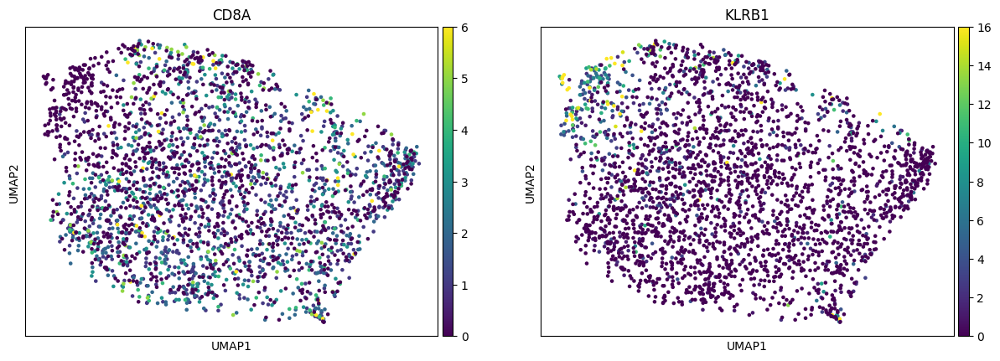

In [126]:
sc.pl.umap(adata, color = ['CD8A','KLRB1'], vmax = 'p99')

### Comparison to original labels

In [127]:
adata = add_labels(adata, original_df)

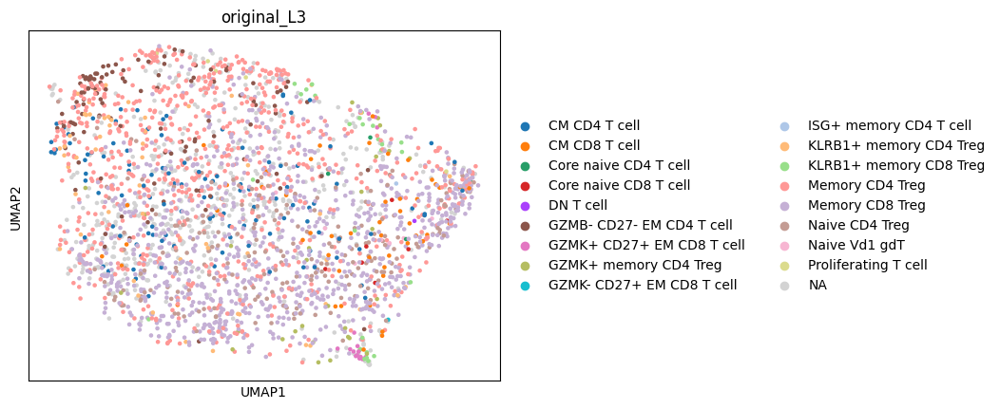

In [128]:
sc.pl.umap(adata, color = 'original_L3')

In [129]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Memory CD8 Treg              892
Memory CD4 Treg              696
NaN                          517
Naive CD4 Treg               220
CM CD4 T cell                113
GZMB- CD27- EM CD4 T cell    111
KLRB1+ memory CD4 Treg        58
CM CD8 T cell                 51
GZMK+ memory CD4 Treg         28
KLRB1+ memory CD8 Treg        27
GZMK+ CD27+ EM CD8 T cell     16
Naive Vd1 gdT                  8
Core naive CD8 T cell          7
Proliferating T cell           5
Core naive CD4 T cell          4
GZMK- CD27+ EM CD8 T cell      1
DN T cell                      1
ISG+ memory CD4 T cell         1
Name: count, dtype: int64

In [130]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Memory CD8 Treg              0.323657
Memory CD4 Treg              0.252540
NaN                          0.187591
Naive CD4 Treg               0.079826
CM CD4 T cell                0.041001
GZMB- CD27- EM CD4 T cell    0.040276
KLRB1+ memory CD4 Treg       0.021045
CM CD8 T cell                0.018505
GZMK+ memory CD4 Treg        0.010160
KLRB1+ memory CD8 Treg       0.009797
GZMK+ CD27+ EM CD8 T cell    0.005806
Naive Vd1 gdT                0.002903
Core naive CD8 T cell        0.002540
Proliferating T cell         0.001814
Core naive CD4 T cell        0.001451
GZMK- CD27+ EM CD8 T cell    0.000363
DN T cell                    0.000363
ISG+ memory CD4 T cell       0.000363
Name: count, dtype: float64

### Proposed updates

- Reassign KLRB1+ cluster as KLRB1+ memory CD4 Treg

## Review Naive CD4 Treg

In [131]:
cell_type = 'Naive CD4 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [132]:
type_uuid

'bb72112f-9bf8-412f-bd52-74059347ec15'

In [133]:
adata = read_adata_uuid(type_uuid)

### Clustering

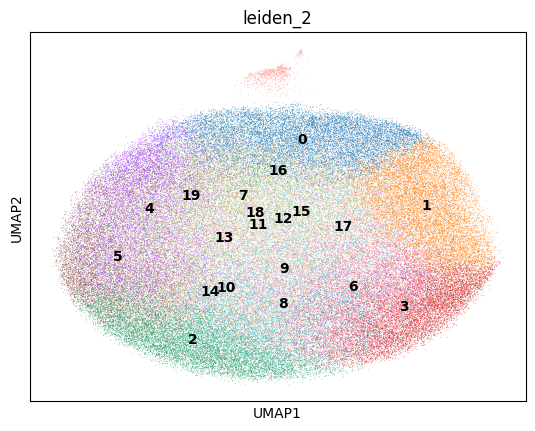

In [134]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

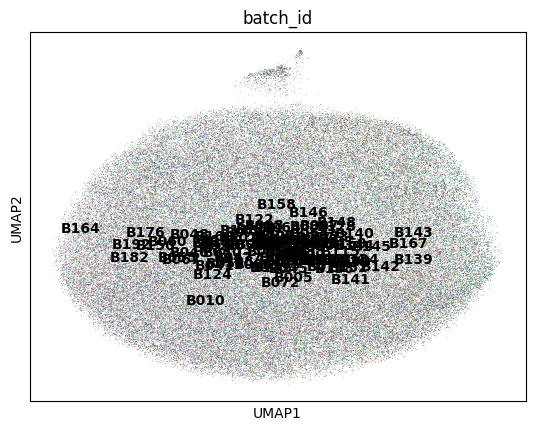

In [135]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

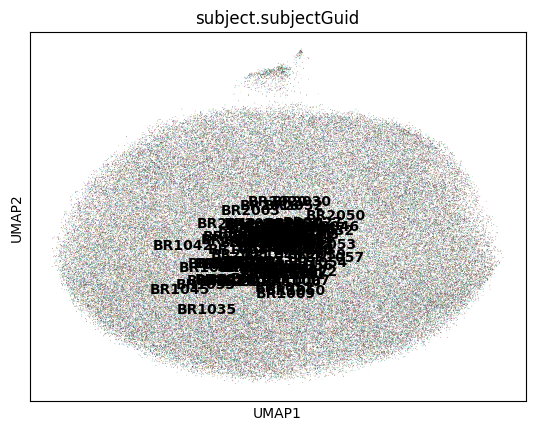

In [136]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

### Marker expression

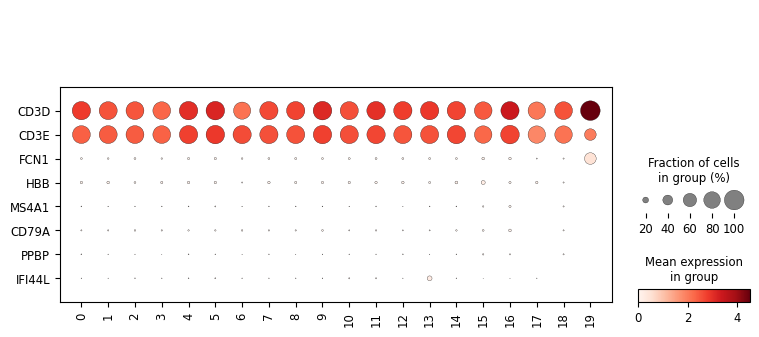

In [137]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

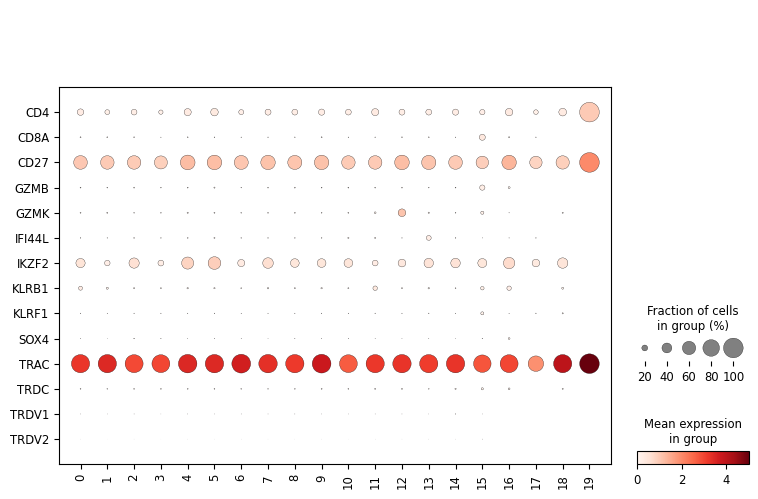

In [138]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

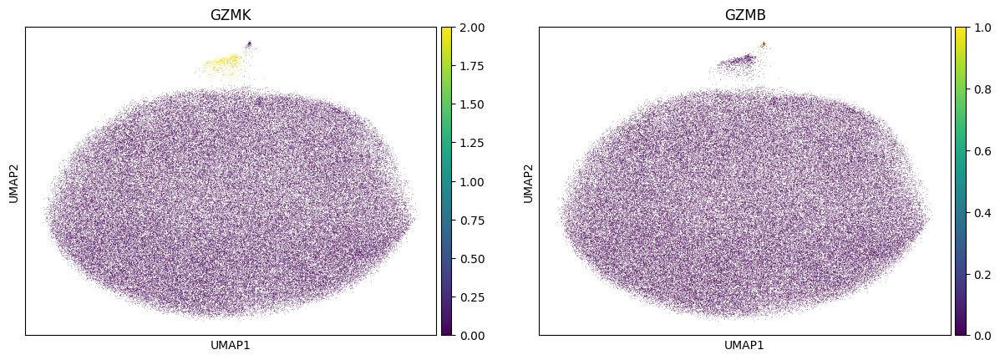

In [139]:
sc.pl.umap(adata, color = ['GZMK','GZMB'], vmax = 'p99')

### Comparison to original labels

In [140]:
adata = add_labels(adata, original_df)

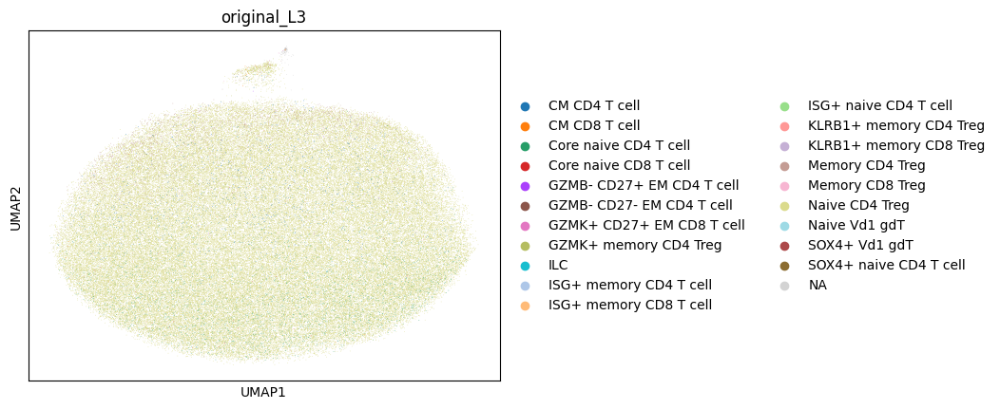

In [141]:
sc.pl.umap(adata, color = 'original_L3')

In [142]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Naive CD4 Treg               118459
Core naive CD4 T cell          3503
Memory CD4 Treg                2226
CM CD4 T cell                  1384
NaN                             588
Memory CD8 Treg                 112
GZMK+ memory CD4 Treg           110
KLRB1+ memory CD4 Treg           83
ISG+ naive CD4 T cell            41
CM CD8 T cell                    39
Core naive CD8 T cell            35
Naive Vd1 gdT                    30
SOX4+ naive CD4 T cell           23
GZMB- CD27- EM CD4 T cell        18
GZMB- CD27+ EM CD4 T cell        16
GZMK+ CD27+ EM CD8 T cell         9
ISG+ memory CD4 T cell            8
KLRB1+ memory CD8 Treg            5
SOX4+ Vd1 gdT                     4
ILC                               1
ISG+ memory CD8 T cell            1
Name: count, dtype: int64

In [143]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Naive CD4 Treg               0.934993
Core naive CD4 T cell        0.027649
Memory CD4 Treg              0.017570
CM CD4 T cell                0.010924
NaN                          0.004641
Memory CD8 Treg              0.000884
GZMK+ memory CD4 Treg        0.000868
KLRB1+ memory CD4 Treg       0.000655
ISG+ naive CD4 T cell        0.000324
CM CD8 T cell                0.000308
Core naive CD8 T cell        0.000276
Naive Vd1 gdT                0.000237
SOX4+ naive CD4 T cell       0.000182
GZMB- CD27- EM CD4 T cell    0.000142
GZMB- CD27+ EM CD4 T cell    0.000126
GZMK+ CD27+ EM CD8 T cell    0.000071
ISG+ memory CD4 T cell       0.000063
KLRB1+ memory CD8 Treg       0.000039
SOX4+ Vd1 gdT                0.000032
ILC                          0.000008
ISG+ memory CD8 T cell       0.000008
Name: count, dtype: float64

### Proposed updates

Iteratively cluster to remove GZMK+ cluster

# Vd1 gdT

## Review KLRF1- effector Vd1 gdT

In [144]:
cell_type = 'KLRF1- effector Vd1 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [145]:
type_uuid

'0f4a74c9-7899-4d0b-91e5-156429aae4df'

In [146]:
adata = read_adata_uuid(type_uuid)

### Clustering

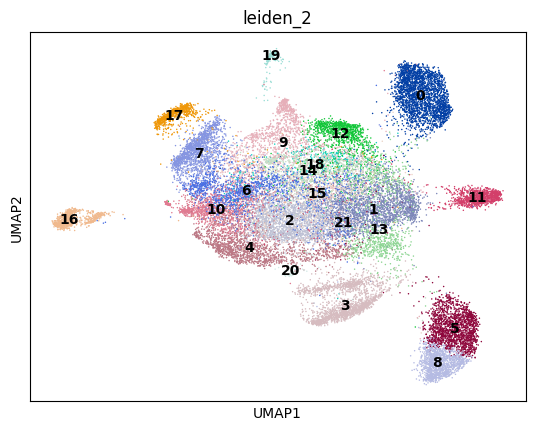

In [147]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

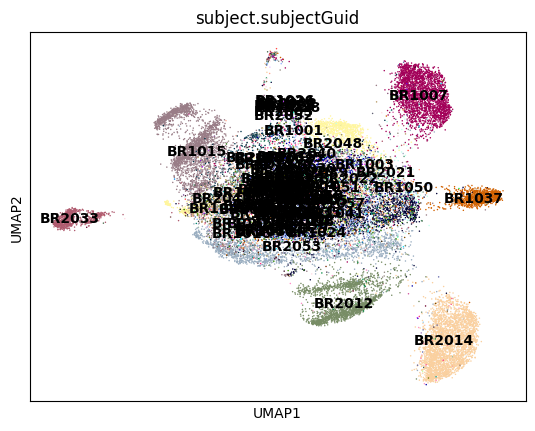

In [148]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

### Marker expression

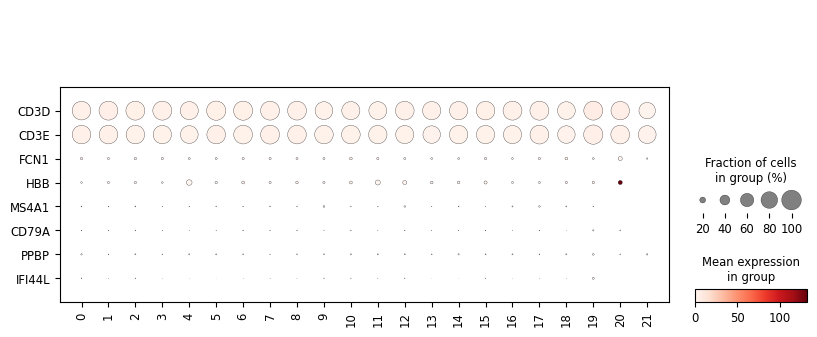

In [149]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

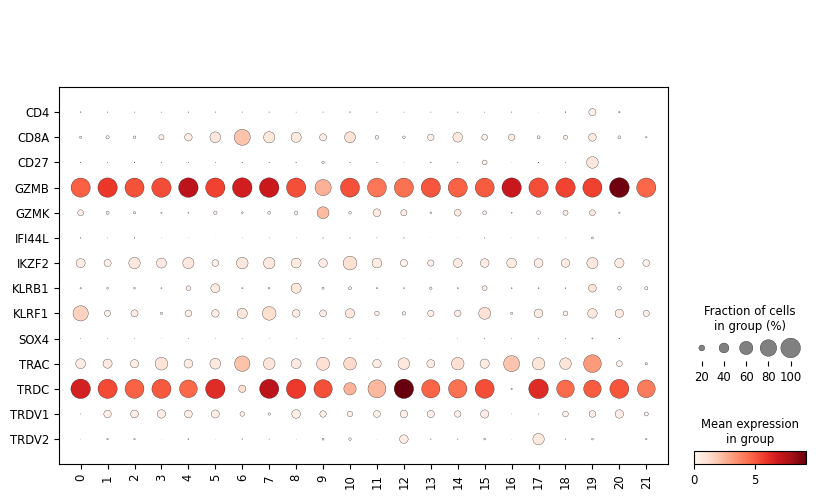

In [150]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

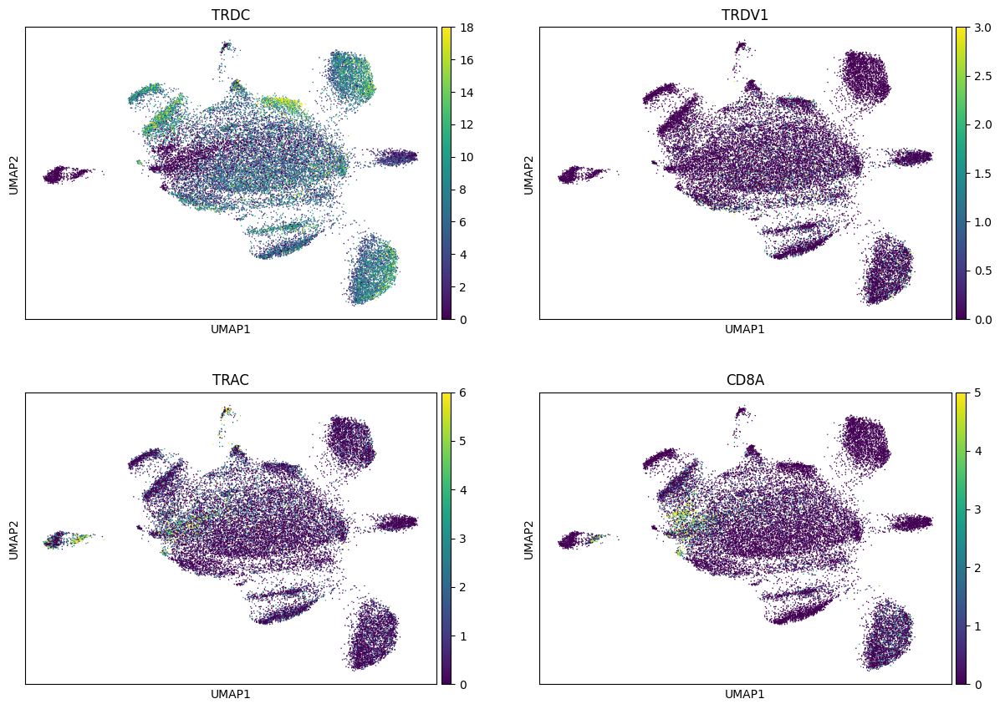

In [151]:
sc.pl.umap(adata, color = ['TRDC','TRDV1','TRAC','CD8A'], vmax = 'p99', ncols = 2)

### Comparison to original labels

In [152]:
adata = add_labels(adata, original_df)

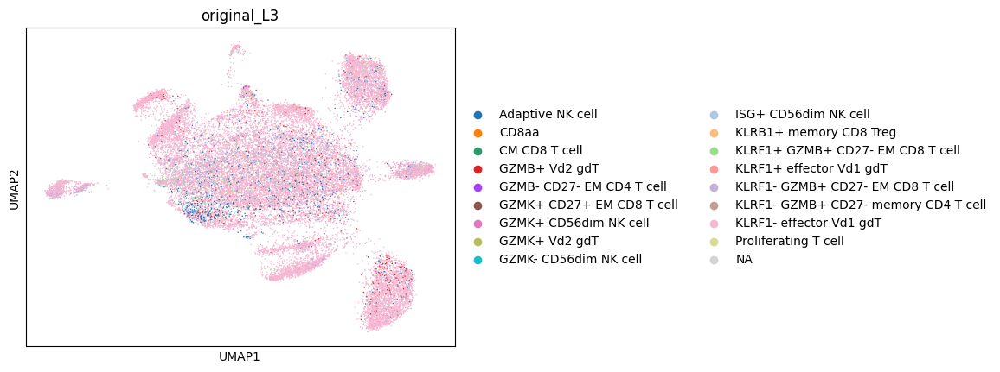

In [153]:
sc.pl.umap(adata, color = 'original_L3')

In [154]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
KLRF1- effector Vd1 gdT                 21257
KLRF1- GZMB+ CD27- EM CD8 T cell         2581
Adaptive NK cell                          933
KLRF1+ effector Vd1 gdT                   560
GZMB+ Vd2 gdT                             401
KLRF1+ GZMB+ CD27- EM CD8 T cell          274
NaN                                       176
KLRF1- GZMB+ CD27- memory CD4 T cell       51
GZMK- CD56dim NK cell                      11
CD8aa                                      11
GZMK+ Vd2 gdT                               7
GZMK+ CD27+ EM CD8 T cell                   5
GZMB- CD27- EM CD4 T cell                   4
Proliferating T cell                        4
CM CD8 T cell                               2
KLRB1+ memory CD8 Treg                      1
GZMK+ CD56dim NK cell                       1
ISG+ CD56dim NK cell                        1
Name: count, dtype: int64

In [155]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
KLRF1- effector Vd1 gdT                 0.808866
KLRF1- GZMB+ CD27- EM CD8 T cell        0.098212
Adaptive NK cell                        0.035502
KLRF1+ effector Vd1 gdT                 0.021309
GZMB+ Vd2 gdT                           0.015259
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.010426
NaN                                     0.006697
KLRF1- GZMB+ CD27- memory CD4 T cell    0.001941
GZMK- CD56dim NK cell                   0.000419
CD8aa                                   0.000419
GZMK+ Vd2 gdT                           0.000266
GZMK+ CD27+ EM CD8 T cell               0.000190
GZMB- CD27- EM CD4 T cell               0.000152
Proliferating T cell                    0.000152
CM CD8 T cell                           0.000076
KLRB1+ memory CD8 Treg                  0.000038
GZMK+ CD56dim NK cell                   0.000038
ISG+ CD56dim NK cell                    0.000038
Name: count, dtype: float64

### Proposed updates

- Remove TRDC-low clusters as mislabeled
- Remove CD27+ cluster as TCRab/gd doublet

## Review KLRF1+ effector Vd1 gdT

In [156]:
cell_type = 'KLRF1+ effector Vd1 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [157]:
type_uuid

'0cd94eb5-45d3-41f0-b08f-7d9a362243ba'

In [158]:
adata = read_adata_uuid(type_uuid)

### Clustering

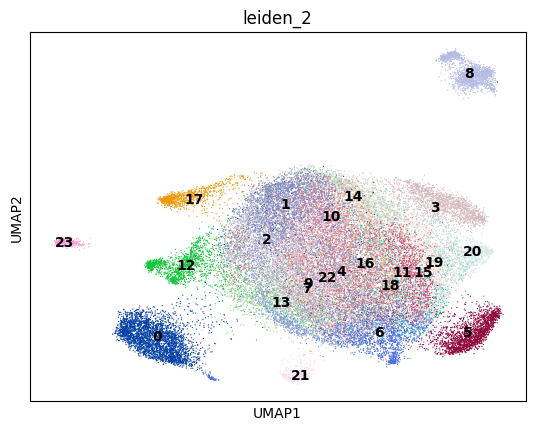

In [159]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

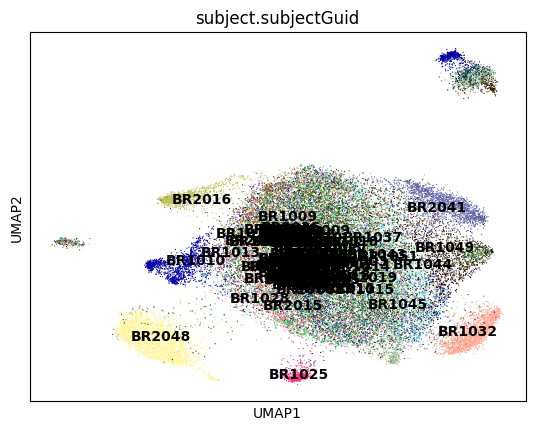

In [160]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

### Marker expression

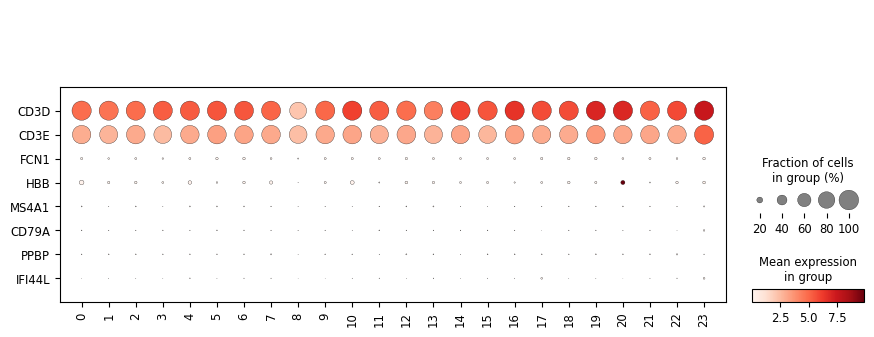

In [161]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

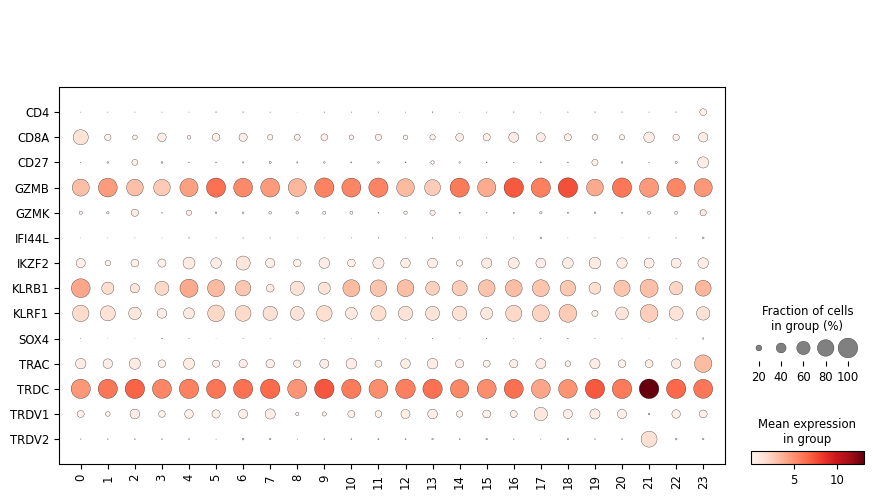

In [162]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

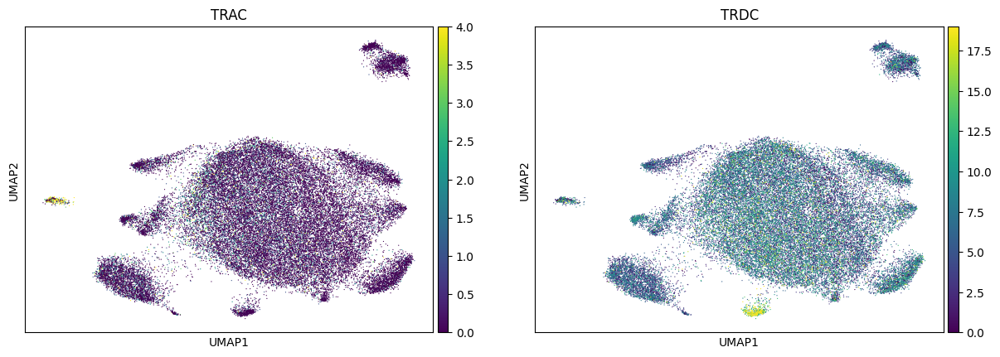

In [163]:
sc.pl.umap(adata, color = ['TRAC','TRDC'], vmax = 'p99')

### Comparison to original labels

In [164]:
adata = add_labels(adata, original_df)

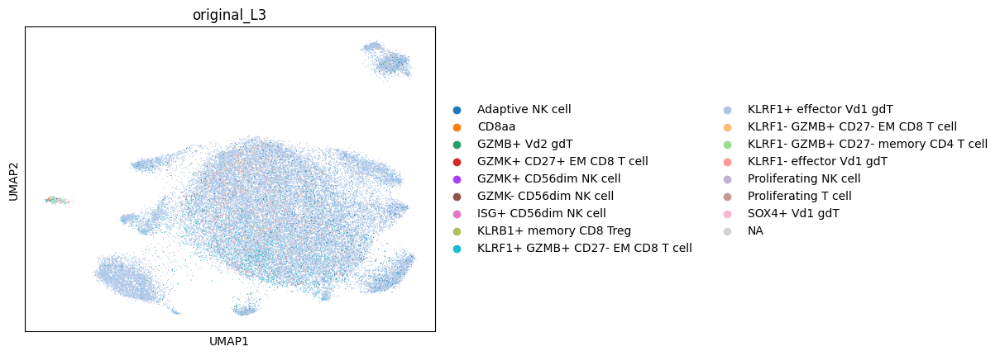

In [165]:
sc.pl.umap(adata, color = 'original_L3')

In [166]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
KLRF1+ effector Vd1 gdT                 33608
KLRF1+ GZMB+ CD27- EM CD8 T cell         1789
Adaptive NK cell                         1441
KLRF1- GZMB+ CD27- EM CD8 T cell          728
NaN                                       654
KLRF1- effector Vd1 gdT                   572
GZMB+ Vd2 gdT                             189
GZMK+ CD27+ EM CD8 T cell                  39
GZMK- CD56dim NK cell                      16
GZMK+ CD56dim NK cell                       6
KLRF1- GZMB+ CD27- memory CD4 T cell        5
Proliferating T cell                        5
CD8aa                                       3
KLRB1+ memory CD8 Treg                      2
ISG+ CD56dim NK cell                        1
Proliferating NK cell                       1
SOX4+ Vd1 gdT                               1
Name: count, dtype: int64

In [167]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
KLRF1+ effector Vd1 gdT                 0.860420
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.045801
Adaptive NK cell                        0.036892
KLRF1- GZMB+ CD27- EM CD8 T cell        0.018638
NaN                                     0.016743
KLRF1- effector Vd1 gdT                 0.014644
GZMB+ Vd2 gdT                           0.004839
GZMK+ CD27+ EM CD8 T cell               0.000998
GZMK- CD56dim NK cell                   0.000410
GZMK+ CD56dim NK cell                   0.000154
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000128
Proliferating T cell                    0.000128
CD8aa                                   0.000077
KLRB1+ memory CD8 Treg                  0.000051
ISG+ CD56dim NK cell                    0.000026
Proliferating NK cell                   0.000026
SOX4+ Vd1 gdT                           0.000026
Name: count, dtype: float64

### Proposed updates

- Reassign TRDV2+ cluster (20) as GZMB+ Vd2 gdT
- Remove TRDC/TRAC+ cluster (21) as ab/gd doublet

## Review Naive Vd1 gdT

In [168]:
cell_type = 'Naive Vd1 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [169]:
type_uuid

'98c1b2e6-fd23-479b-8dae-6fa50e1dcf86'

In [170]:
adata = read_adata_uuid(type_uuid)

### Clustering

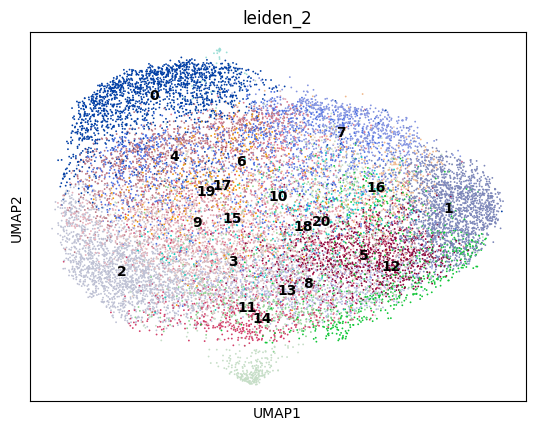

In [171]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

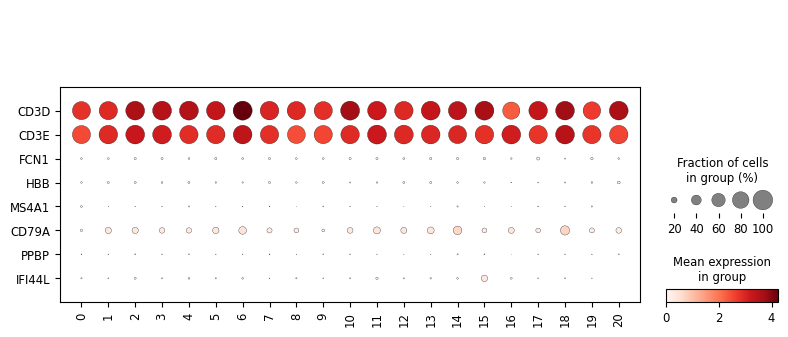

In [172]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

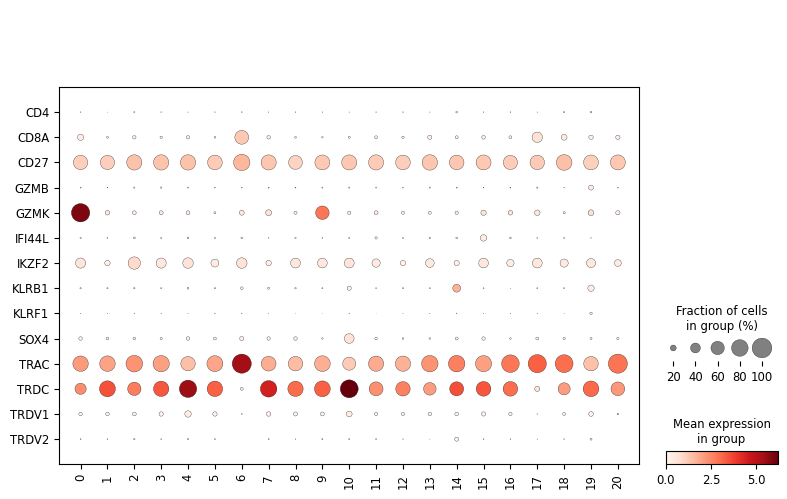

In [173]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

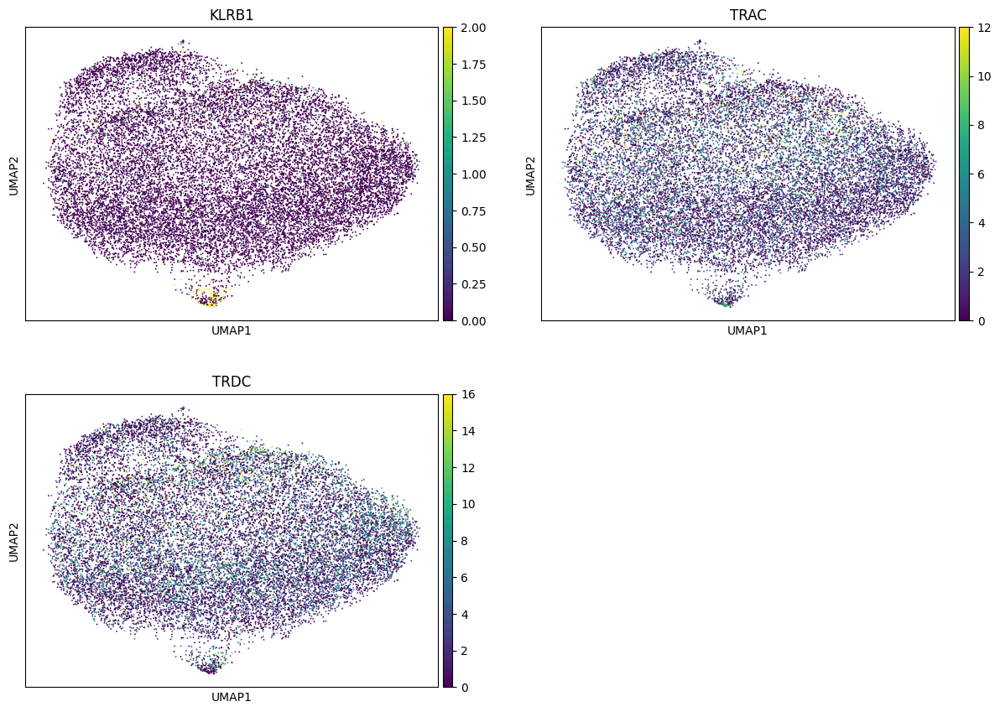

In [174]:
sc.pl.umap(adata, color = ['KLRB1','TRAC','TRDC'], vmax = 'p99', ncols = 2)

### Comparison to original labels

In [175]:
adata = add_labels(adata, original_df)

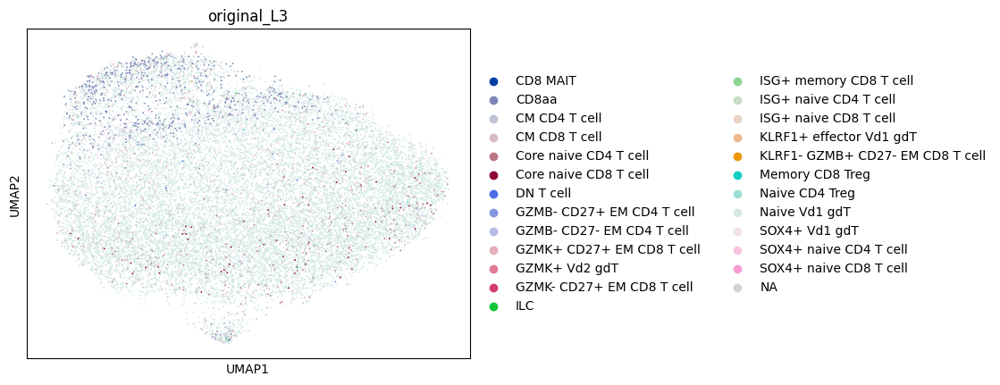

In [176]:
sc.pl.umap(adata, color = 'original_L3')

In [177]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Naive Vd1 gdT                       14517
CM CD8 T cell                        1051
SOX4+ Vd1 gdT                         689
CD8aa                                 680
NaN                                   248
Core naive CD4 T cell                 187
Core naive CD8 T cell                  60
CM CD4 T cell                          58
Naive CD4 Treg                         39
GZMK+ CD27+ EM CD8 T cell              16
GZMB- CD27+ EM CD4 T cell              14
GZMK+ Vd2 gdT                          12
SOX4+ naive CD8 T cell                  8
ISG+ naive CD4 T cell                   6
DN T cell                               5
SOX4+ naive CD4 T cell                  3
ILC                                     3
GZMB- CD27- EM CD4 T cell               3
Memory CD8 Treg                         2
ISG+ naive CD8 T cell                   2
ISG+ memory CD8 T cell                  2
GZMK- CD27+ EM CD8 T cell               2
CD8 MAIT                                2
KLRF1- GZMB+ CD27- EM 

In [178]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Naive Vd1 gdT                       0.824314
CM CD8 T cell                       0.059679
SOX4+ Vd1 gdT                       0.039123
CD8aa                               0.038612
NaN                                 0.014082
Core naive CD4 T cell               0.010618
Core naive CD8 T cell               0.003407
CM CD4 T cell                       0.003293
Naive CD4 Treg                      0.002215
GZMK+ CD27+ EM CD8 T cell           0.000909
GZMB- CD27+ EM CD4 T cell           0.000795
GZMK+ Vd2 gdT                       0.000681
SOX4+ naive CD8 T cell              0.000454
ISG+ naive CD4 T cell               0.000341
DN T cell                           0.000284
SOX4+ naive CD4 T cell              0.000170
ILC                                 0.000170
GZMB- CD27- EM CD4 T cell           0.000170
Memory CD8 Treg                     0.000114
ISG+ naive CD8 T cell               0.000114
ISG+ memory CD8 T cell              0.000114
GZMK- CD27+ EM CD8 T cell           0.00011

### Proposed updates

- Remove KLRB1+ cluster as Mislabeled
- Remove TRDC- clusters (6, 17) as ab mislabeled

## Review SOX4+ Vd1 gdT

In [179]:
cell_type = 'SOX4+ Vd1 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [180]:
type_uuid

'2e15c2c7-0ba5-480d-b476-b1bb2f594e40'

In [181]:
adata = read_adata_uuid(type_uuid)

### Clustering

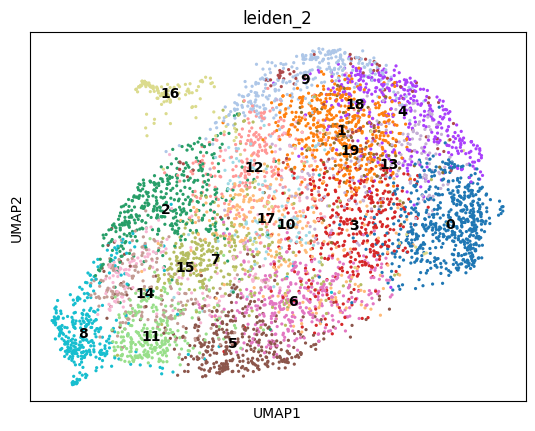

In [182]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

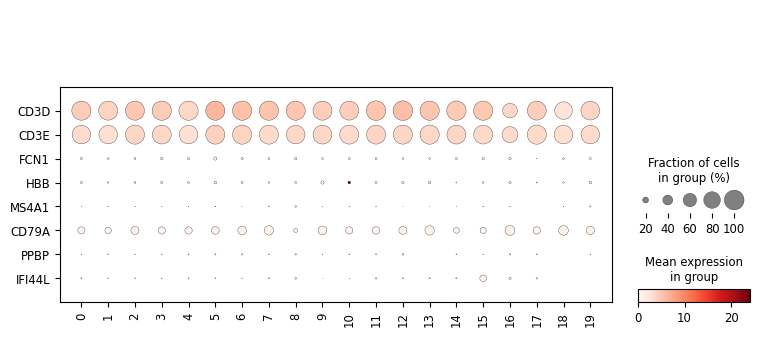

In [183]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

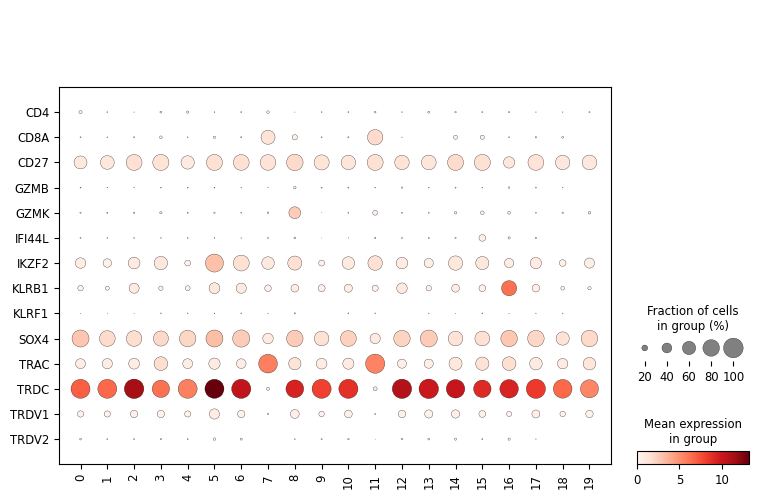

In [184]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

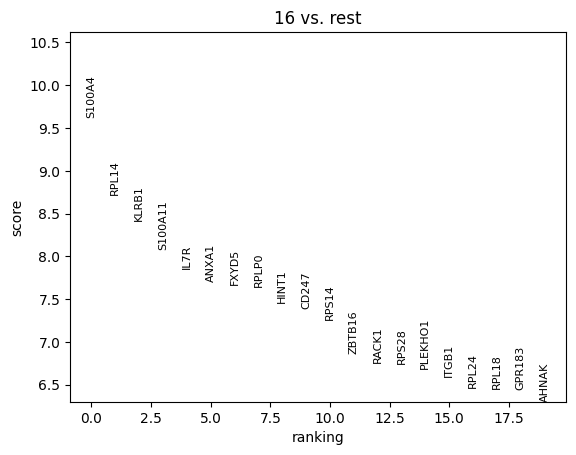

In [185]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['16']
)
sc.pl.rank_genes_groups(adata, ncols = 2)

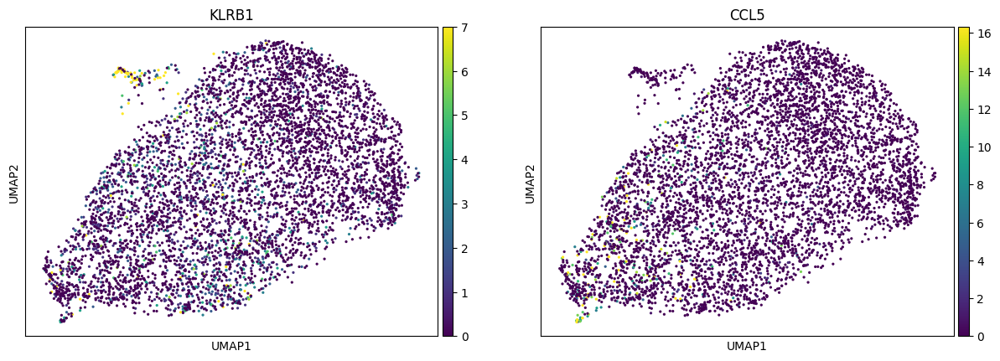

In [186]:
sc.pl.umap(adata, color = ['KLRB1','CCL5'], vmax = 'p99')

### Comparison to original labels

In [187]:
adata = add_labels(adata, original_df)

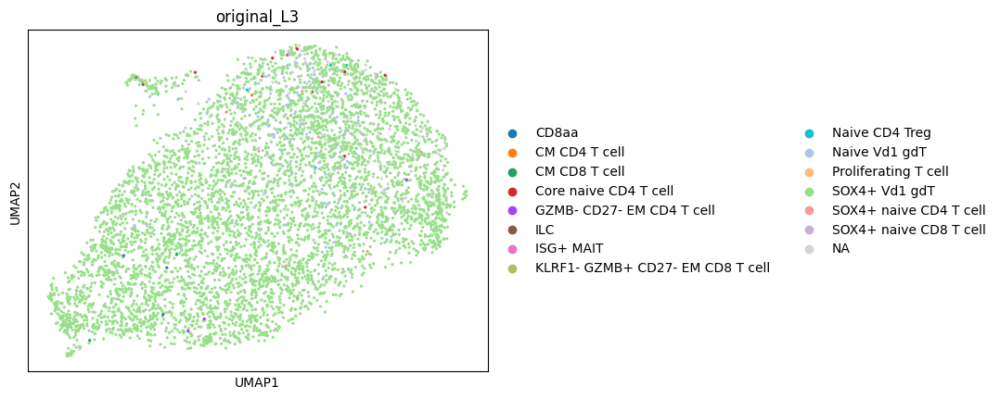

In [188]:
sc.pl.umap(adata, color = 'original_L3')

In [189]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
SOX4+ Vd1 gdT                       5111
NaN                                  248
Naive Vd1 gdT                        164
Core naive CD4 T cell                 12
SOX4+ naive CD4 T cell                 8
SOX4+ naive CD8 T cell                 5
Naive CD4 Treg                         4
CD8aa                                  3
GZMB- CD27- EM CD4 T cell              3
ILC                                    3
CM CD4 T cell                          2
CM CD8 T cell                          2
ISG+ MAIT                              1
KLRF1- GZMB+ CD27- EM CD8 T cell       1
Proliferating T cell                   1
Name: count, dtype: int64

In [190]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
SOX4+ Vd1 gdT                       0.917924
NaN                                 0.044540
Naive Vd1 gdT                       0.029454
Core naive CD4 T cell               0.002155
SOX4+ naive CD4 T cell              0.001437
SOX4+ naive CD8 T cell              0.000898
Naive CD4 Treg                      0.000718
CD8aa                               0.000539
GZMB- CD27- EM CD4 T cell           0.000539
ILC                                 0.000539
CM CD4 T cell                       0.000359
CM CD8 T cell                       0.000359
ISG+ MAIT                           0.000180
KLRF1- GZMB+ CD27- EM CD8 T cell    0.000180
Proliferating T cell                0.000180
Name: count, dtype: float64

### Proposed updates

- Remove KLRB1+ cluster as Mislabeled
- Remove TRDC- clusters as Mislabeled

# Vd2 gdT

## Review GZMB+ Vd2 gdT

In [191]:
cell_type = 'GZMB+ Vd2 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [192]:
type_uuid

'427f1a02-2ada-4da0-80e3-be3831df9ed3'

In [193]:
adata = read_adata_uuid(type_uuid)

### Clustering

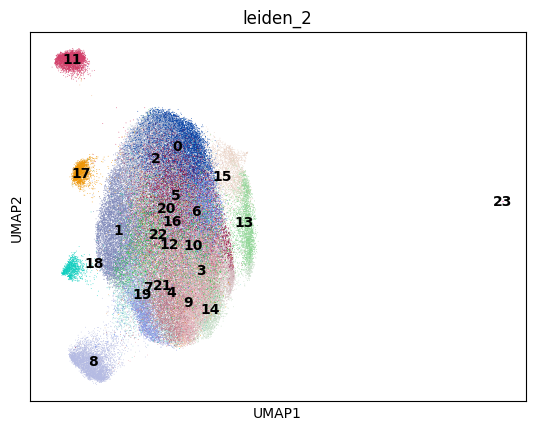

In [194]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

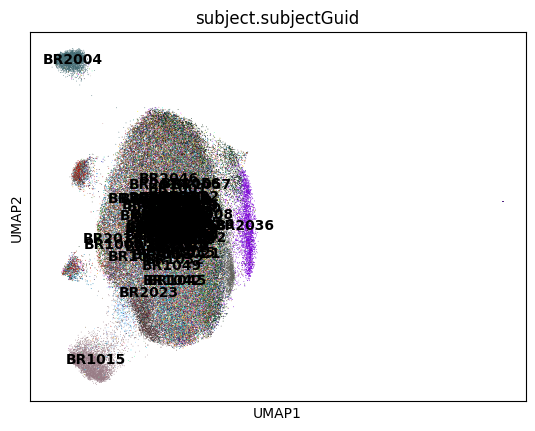

In [195]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

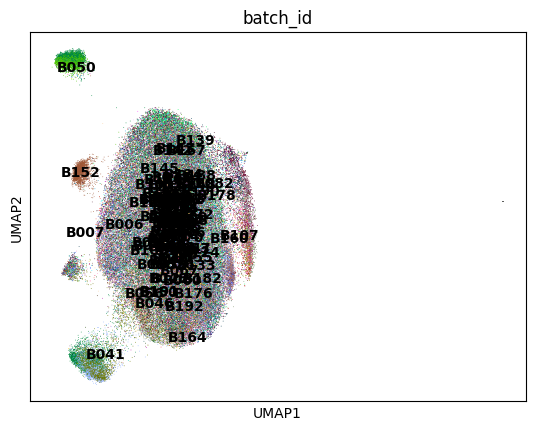

In [196]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

### Marker expression

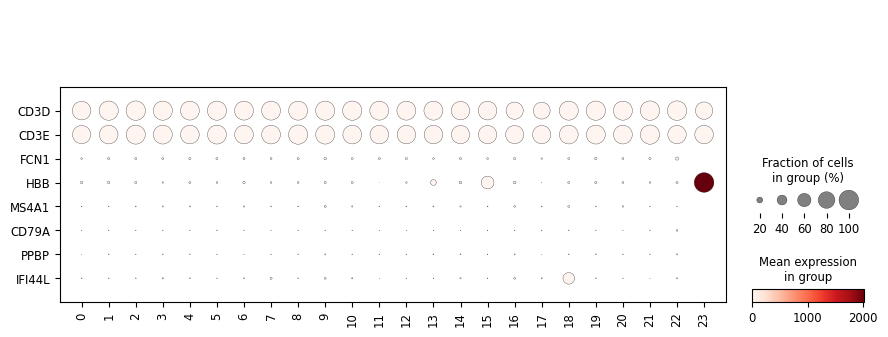

In [197]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

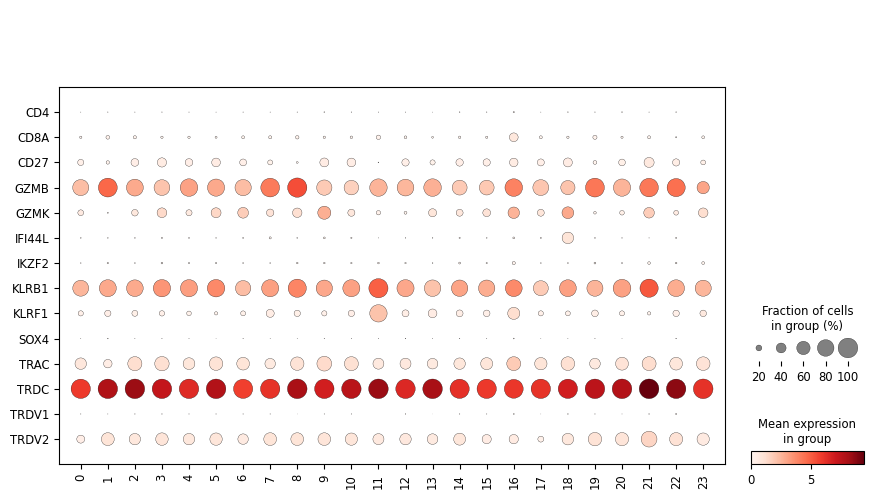

In [198]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Comparison to original labels

In [199]:
adata = add_labels(adata, original_df)

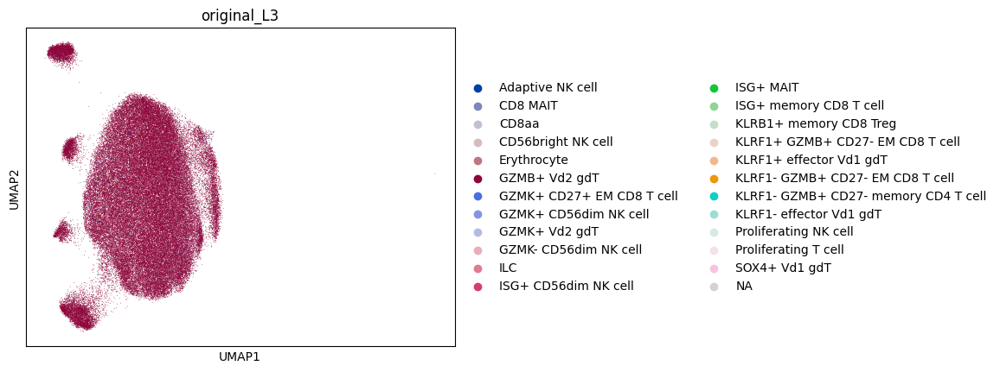

In [200]:
sc.pl.umap(adata, color = 'original_L3')

In [201]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
GZMB+ Vd2 gdT                           88740
GZMK+ Vd2 gdT                            1710
KLRF1- GZMB+ CD27- EM CD8 T cell          508
NaN                                       440
Adaptive NK cell                          384
KLRF1- effector Vd1 gdT                   280
KLRF1+ effector Vd1 gdT                   234
GZMK- CD56dim NK cell                      94
KLRF1+ GZMB+ CD27- EM CD8 T cell           85
KLRF1- GZMB+ CD27- memory CD4 T cell       70
GZMK+ CD56dim NK cell                      44
GZMK+ CD27+ EM CD8 T cell                  16
ISG+ CD56dim NK cell                        9
Proliferating T cell                        8
ISG+ MAIT                                   6
Proliferating NK cell                       5
CD56bright NK cell                          3
CD8 MAIT                                    3
ISG+ memory CD8 T cell                      3
Erythrocyte                                 2
KLRB1+ memory CD8 Treg                      2
CD8aa                 

In [202]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
GZMB+ Vd2 gdT                           0.957809
GZMK+ Vd2 gdT                           0.018457
KLRF1- GZMB+ CD27- EM CD8 T cell        0.005483
NaN                                     0.004749
Adaptive NK cell                        0.004145
KLRF1- effector Vd1 gdT                 0.003022
KLRF1+ effector Vd1 gdT                 0.002526
GZMK- CD56dim NK cell                   0.001015
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000917
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000756
GZMK+ CD56dim NK cell                   0.000475
GZMK+ CD27+ EM CD8 T cell               0.000173
ISG+ CD56dim NK cell                    0.000097
Proliferating T cell                    0.000086
ISG+ MAIT                               0.000065
Proliferating NK cell                   0.000054
CD56bright NK cell                      0.000032
CD8 MAIT                                0.000032
ISG+ memory CD8 T cell                  0.000032
Erythrocyte                             0.000022
KLRB1+ m

### Proposed updates

Remove HBB+ cluster as Erythrocyte doublet

## Review GZMK+ Vd2 gdT

In [203]:
cell_type = 'GZMK+ Vd2 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [204]:
type_uuid

'dce3a864-0d67-4995-b8bf-373fa563cfe0'

In [205]:
adata = read_adata_uuid(type_uuid)

### Clustering

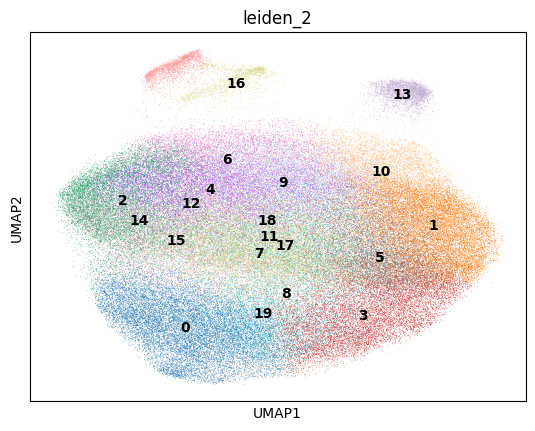

In [206]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

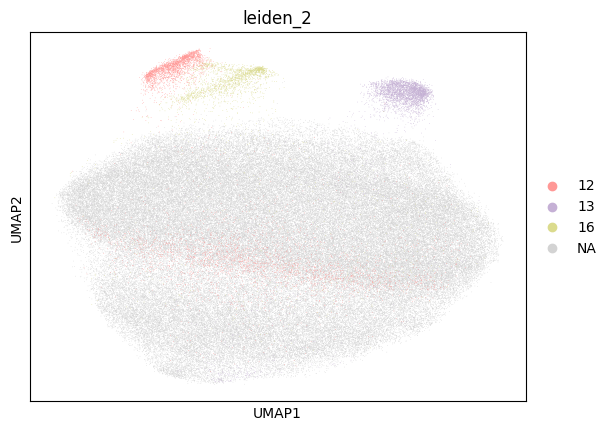

In [207]:
sc.pl.umap(adata, color = 'leiden_2', groups = ['12','13','16'])

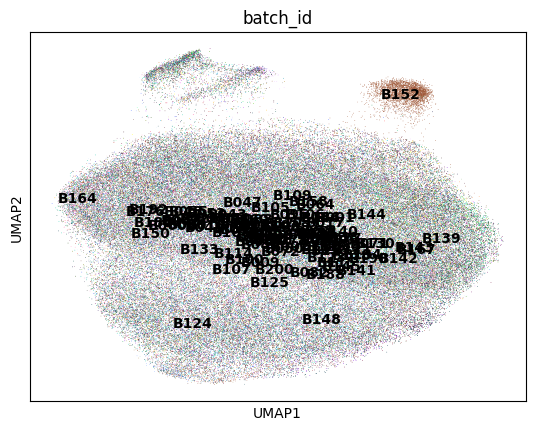

In [208]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

### Marker expression

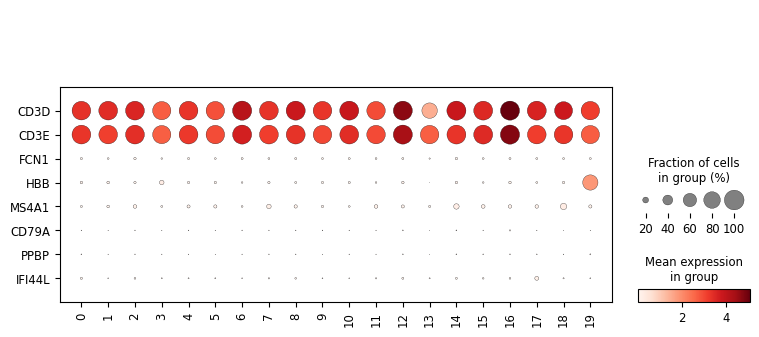

In [209]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

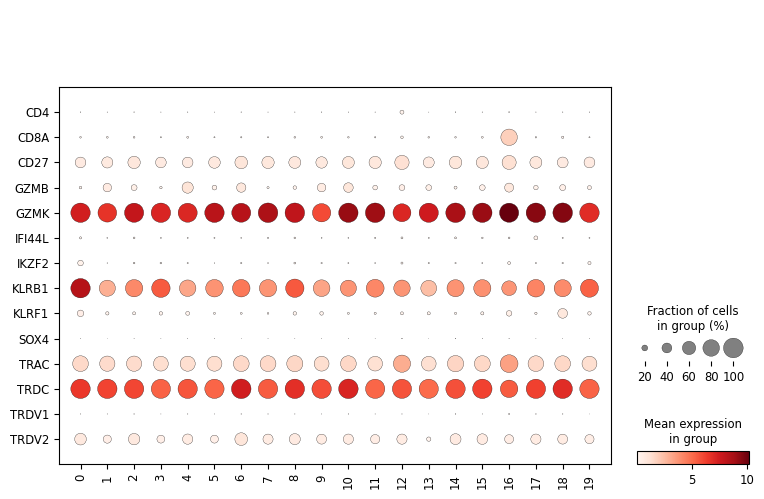

In [210]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

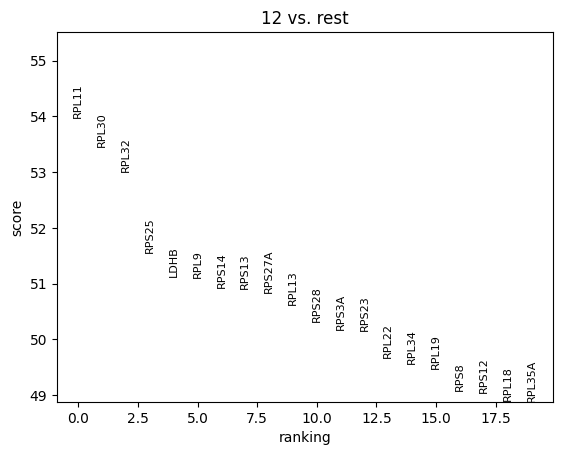

In [211]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['12']
)
sc.pl.rank_genes_groups(adata, ncols = 2)

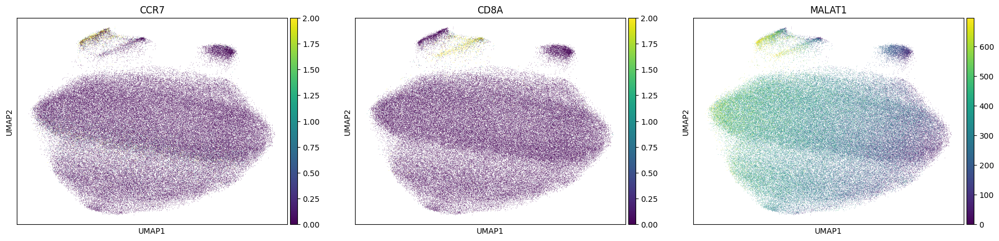

In [212]:
sc.pl.umap(adata, color = ['CCR7','CD8A','MALAT1'], vmax = 'p99')

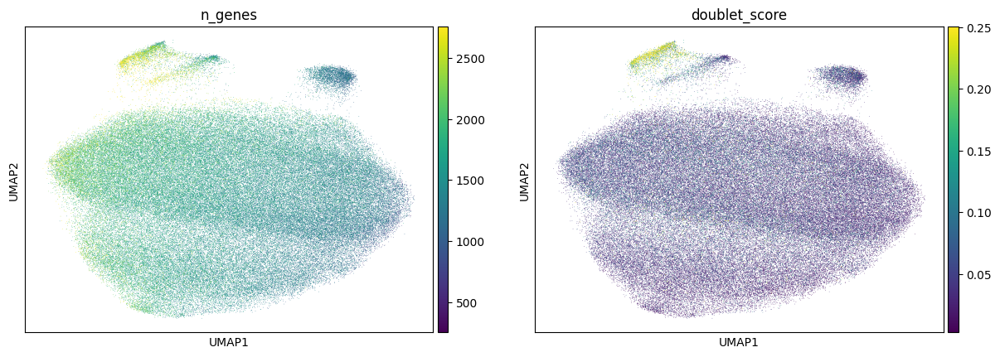

In [213]:
sc.pl.umap(adata, color = ['n_genes', 'doublet_score'], vmax = 'p99')

### Comparison to original labels

In [214]:
adata = add_labels(adata, original_df)

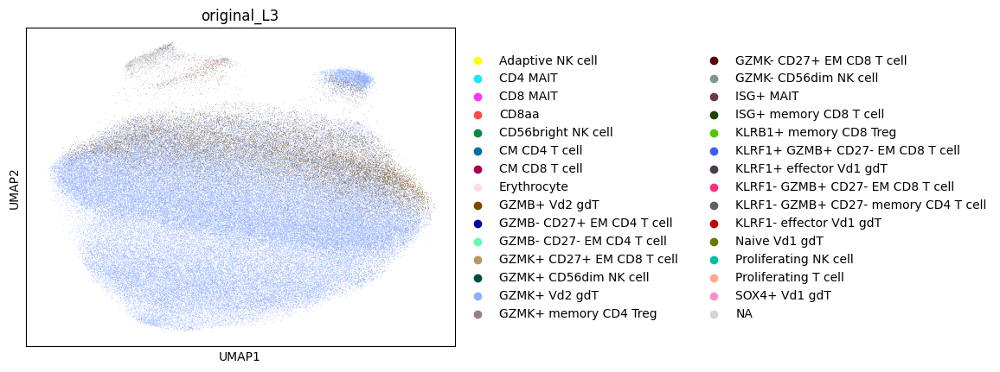

In [215]:
sc.pl.umap(adata, color = 'original_L3')

In [216]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
GZMK+ Vd2 gdT                           106577
GZMB+ Vd2 gdT                            15353
NaN                                       5308
GZMK+ CD27+ EM CD8 T cell                  701
CD8 MAIT                                   589
CM CD8 T cell                              126
GZMK+ CD56dim NK cell                       86
GZMB- CD27+ EM CD4 T cell                   78
KLRF1- GZMB+ CD27- EM CD8 T cell            62
KLRF1+ GZMB+ CD27- EM CD8 T cell            61
CD8aa                                       59
KLRF1+ effector Vd1 gdT                     27
ISG+ MAIT                                   25
KLRF1- GZMB+ CD27- memory CD4 T cell        22
KLRF1- effector Vd1 gdT                     18
CD4 MAIT                                    17
Naive Vd1 gdT                                8
CD56bright NK cell                           8
Adaptive NK cell                             6
KLRB1+ memory CD8 Treg                       5
Proliferating T cell                         5
G

In [217]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
GZMK+ Vd2 gdT                           0.825129
GZMB+ Vd2 gdT                           0.118864
NaN                                     0.041095
GZMK+ CD27+ EM CD8 T cell               0.005427
CD8 MAIT                                0.004560
CM CD8 T cell                           0.000976
GZMK+ CD56dim NK cell                   0.000666
GZMB- CD27+ EM CD4 T cell               0.000604
KLRF1- GZMB+ CD27- EM CD8 T cell        0.000480
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000472
CD8aa                                   0.000457
KLRF1+ effector Vd1 gdT                 0.000209
ISG+ MAIT                               0.000194
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000170
KLRF1- effector Vd1 gdT                 0.000139
CD4 MAIT                                0.000132
Naive Vd1 gdT                           0.000062
CD56bright NK cell                      0.000062
Adaptive NK cell                        0.000046
KLRB1+ memory CD8 Treg                  0.000039
Prolifer

### Proposed updates

- Remove CD8A+ and CD4+ clusters as doublets
- Remove Doublet score-high cluster as doublets

## Review Proliferating T cell

In [218]:
cell_type = 'Proliferating T cell'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [219]:
type_uuid

'68f264fe-e653-4257-b65d-d5e33a4754bb'

In [220]:
adata = read_adata_uuid(type_uuid)

### Clustering

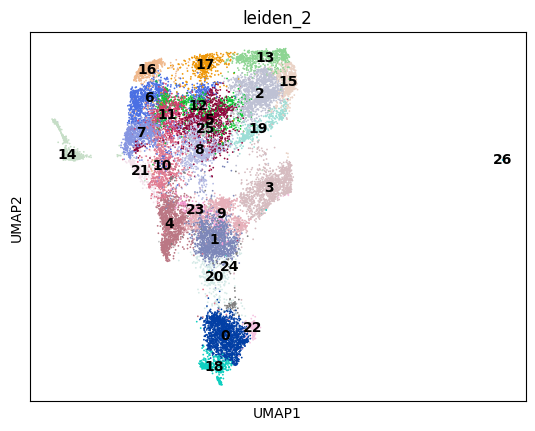

In [221]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

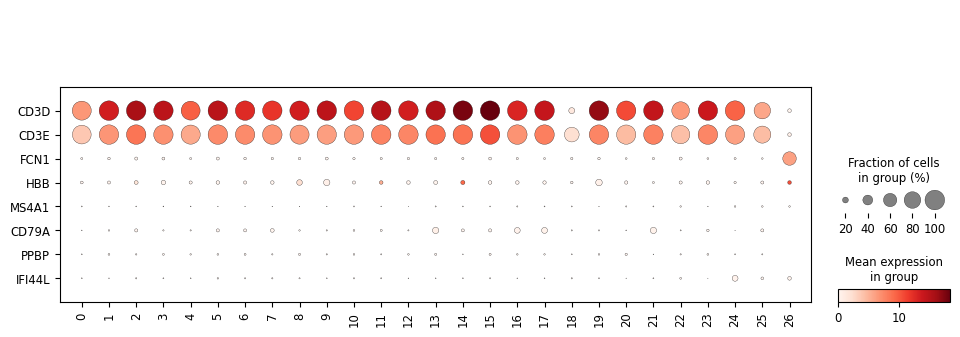

In [222]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

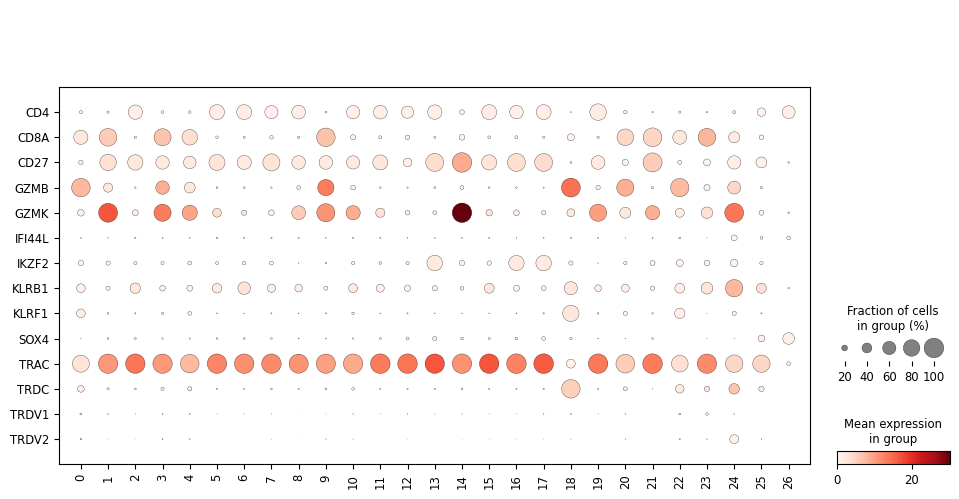

In [223]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

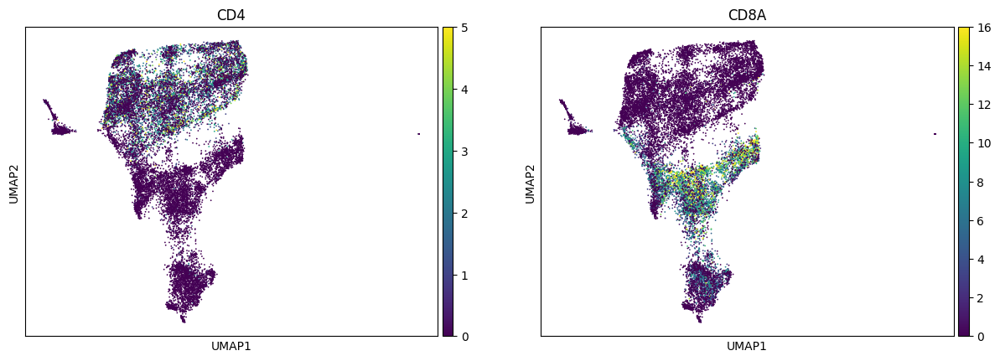

In [224]:
sc.pl.umap(adata, color = ['CD4','CD8A'], vmax = 'p99')

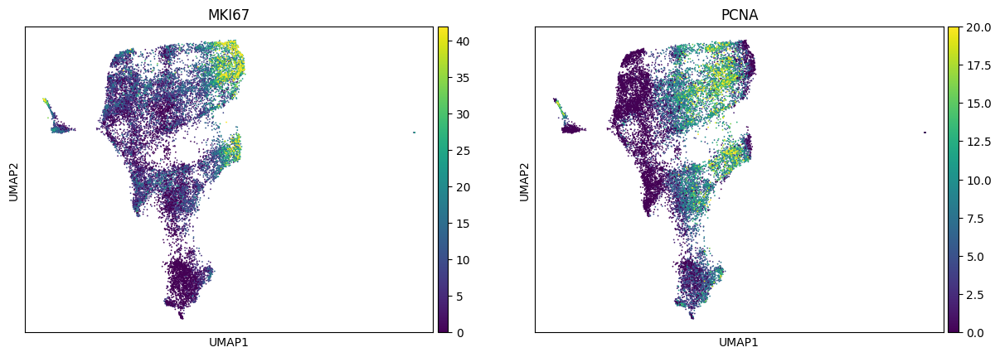

In [225]:
sc.pl.umap(adata, color = ['MKI67','PCNA'], vmax = 'p99')

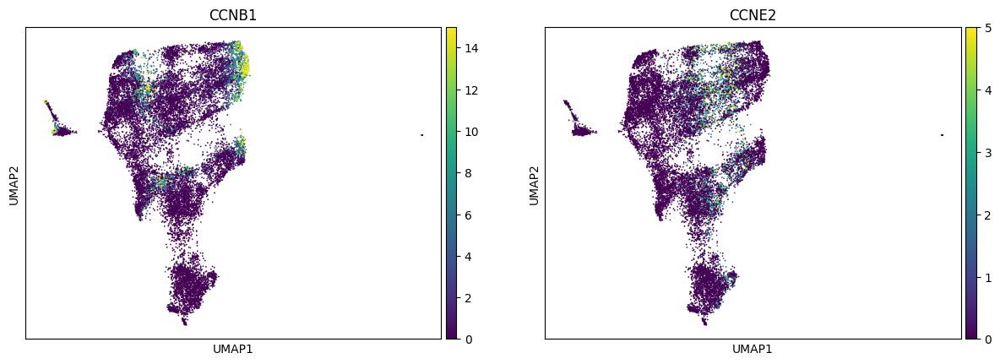

In [226]:
sc.pl.umap(adata, color = ['CCNB1','CCNE2'], vmax = 'p99')

### Comparison to original labels

In [227]:
adata = add_labels(adata, original_df)

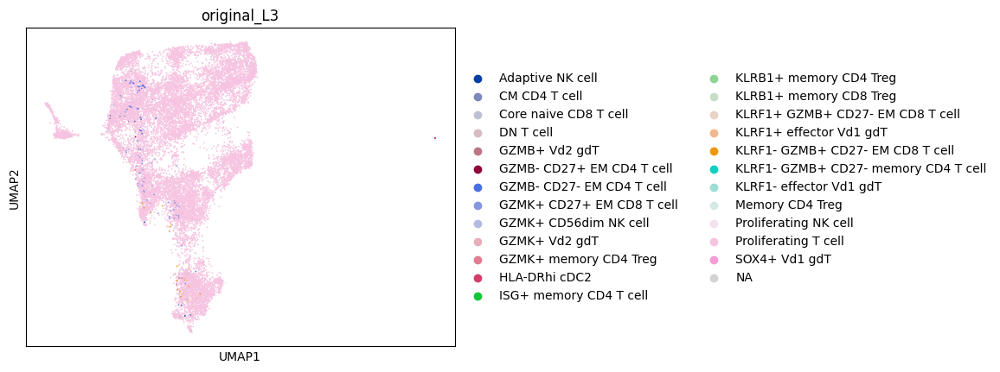

In [228]:
sc.pl.umap(adata, color = 'original_L3')

In [229]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Proliferating T cell                    17917
Proliferating NK cell                     142
NaN                                        82
GZMK+ CD27+ EM CD8 T cell                  78
GZMB- CD27- EM CD4 T cell                  60
KLRF1- GZMB+ CD27- EM CD8 T cell           31
HLA-DRhi cDC2                              18
CM CD4 T cell                              17
Adaptive NK cell                           10
DN T cell                                   9
KLRF1+ effector Vd1 gdT                     8
KLRF1+ GZMB+ CD27- EM CD8 T cell            7
GZMB+ Vd2 gdT                               5
Memory CD4 Treg                             4
KLRB1+ memory CD4 Treg                      3
KLRF1- GZMB+ CD27- memory CD4 T cell        3
KLRF1- effector Vd1 gdT                     2
Core naive CD8 T cell                       2
ISG+ memory CD4 T cell                      2
GZMK+ Vd2 gdT                               1
GZMK+ memory CD4 Treg                       1
GZMK+ CD56dim NK cell 

In [230]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Proliferating T cell                    0.973433
Proliferating NK cell                   0.007715
NaN                                     0.004455
GZMK+ CD27+ EM CD8 T cell               0.004238
GZMB- CD27- EM CD4 T cell               0.003260
KLRF1- GZMB+ CD27- EM CD8 T cell        0.001684
HLA-DRhi cDC2                           0.000978
CM CD4 T cell                           0.000924
Adaptive NK cell                        0.000543
DN T cell                               0.000489
KLRF1+ effector Vd1 gdT                 0.000435
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000380
GZMB+ Vd2 gdT                           0.000272
Memory CD4 Treg                         0.000217
KLRB1+ memory CD4 Treg                  0.000163
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000163
KLRF1- effector Vd1 gdT                 0.000109
Core naive CD8 T cell                   0.000109
ISG+ memory CD4 T cell                  0.000109
GZMK+ Vd2 gdT                           0.000054
GZMK+ me

### Proposed updates

- Remove CD3D- clusters (22 and 27) as Non-T
- Remove FCN1+ cluster as Myeloid doublet

In [231]:
os.system('jupyter nbconvert --to html --template pj 11d-Python_review_L3_other_t_cell_data.ipynb')

[NbConvertApp] WARNING | Config option `kernel_spec_manager_class` not recognized by `NbConvertApp`.
[NbConvertApp] Converting notebook 11d-Python_review_L3_other_t_cell_data.ipynb to html
[NbConvertApp] Writing 34561003 bytes to 11d-Python_review_L3_other_t_cell_data.html


0

In [232]:
import session_info
session_info.show()